# Executive Summary

## Problem Statement

This study delves into the capabilities of the 3GPP Network Data Analytics Function (NWDAF) in predicting 'abnormal' traffic through the utilization of a Model Based Forecaster System (MBFS).

Figures 1 and 2 illustrate that the NWDAF identifies traffic patterns based on a locally trained model, with each NWDAF being responsible for training its own model. In a Distributed NWDAF setup, an aggregator compiles traffic data from various NWDAFs to create a globally shared model. The primary benefit of a global model is its ability to capture fundamental time series patterns, identify additional patterns resulting from series correlations, and streamline operations by utilizing a single model. Additionally, Figure 1 showcases the use of multiple series at a local level by combining different local time series, specifically those linked to the MAF and the SMF. This approach serves as a middle ground between a locally specialized NWDAF model and a fully global NWDAF model. The evaluation presented in this document focuses on a Distributed NWDAF that relies on a single global model trained with multiple series, comparing its feasibility and performance against a Local NWDAF.

<figure>
  <img src="./single_nwdaf_fig.svg" width="60%" />
  <figcaption>Fig 1. Localized Network Data Analytics Function (NWDAF)</figcaption>
</figure>
<figure>
  <img src="./multi_nwdaf_multi_nf.svg" width="60%" />
  <figcaption>Fig 2. Distributed Network Data Analytics Function (NWDAF)</figcaption>
</figure>

## Description of the Model Based Forecaster System (MBFS) 
In Figure 3, the MBFS utilizes a single or multiple time series as input to predict the next 'step' elements as either 'normal' or 'abnormal' based on the last 'lag' elements. The MBFS consists of a trained Forecaster that assigns a probability to each instant in the output time series, indicating whether the element is 'abnormal'. Subsequently, a Classifier processes the output time series and classifies each measurement as 'normal' or 'abnormal' based on the assigned probability. It is important to note that due to the limitation on 'step', predictions are expected to occur regularly. In order to run the further predictions, the observed traffic is used as input for the subsequent prediction.

<figure>
  <img src="./mbfs_fig.svg" width="60%" />
  <figcaption>Fig 3. Model Based Forecaster System (MBFS)</figcaption>
</figure>

## Experimental Results

Our model construction began with the utilization of a single time series, employing autoregressive forecasters with or without exogenous data. Each forecaster was paired with two types of regressors: a random forest regressor and a linear ridge regressor. We carefully determined a suitable 'lag' and 'step' for each combination of forecaster and regressor, striking a balance between operational efficiency and performance. Ultimately, we opted for an autoregressive forecaster with exogenous data, paired with a random forest regressor, showcasing the specific characteristics outlined below:

| Forcaster / Regressor   |  ForecasterAutoregWithExog / Random Forest |
|-------------------------|--------------------------------------------|
| optimum lag             |  94                                        |
| optimum PR AUC          |  ~=0.95, L∞=0.02                           |
| selected_lag            |  94 +/- 100                                |
| model size (KB)         | 2673.87                                    |
| predition time (s)      |  ~=41.77, L∞=41.16                         |
| fit time (s)            | ~=10.69                                    |
| PR AUC                  |  ~=0.95, L∞=0.02                           |
| Mean Square Error       |  ~=0.17, L∞=0.03                           |
| Mean Absolute Error     |  ~=0.19, L∞=0.03                           |
| R2 Score                |  ~=-0.05, L∞=0.18                          |
| steps Prediction        |  F1 (90,70) Pr (124,70)                    |
| f1_binary               |  ~=0.88, L∞=0.01                           |
| f1_micro                |  ~=0.79, L∞=0.02                           |
| accuracy                |  ~=0.79, L∞=0.02                           |
| precision_binary        |  ~=0.87, L∞=0.21                           |
| precision_micro         |  ~=0.79, L∞=0.02                           |
| average_precision_micro |  ~=0.80, L∞=0.03                           |
| recall_binary           |  ~=1.00, L∞=0.03                           |
| recall_micro            |  ~=0.79, L∞=0.02                           |

Based on the 'lag' of 94 seconds, 'steps' of 90 seconds, and a prediction time (tp) of 42 seconds, the model is suitable for deployment since the training time is within the prediction time limit - usually 'steps' > 2 * tp as shown in Figure 4.

<figure>
  <img src="./time_line.svg" width="60%" />
  <figcaption>Fig 4. Time Line Deployment </figcaption>
</figure>

The next step in our process involves comparing the prediction model derived from a single time series with the use of multiple parallel time series, as summarized in the table below. We have utilized 75 different time series, resulting in 75 prediction outputs. When considering the deployment aspect, it is evident that the prediction time, denoted as tp, does not meet our deployment conditions. However, an increase of 50% in the prediction time does not pose an insurmountable challenge. It is worth mentioning that the current implementation of the multiple time series model provides batch predictions for the 75 time series. Consequently, the actual prediction time suggests that the necessary computational resources for prediction are halved when comparing the use of multiple time series to the individual computation of the 75 local predictions.

Furthermore, it should be noted that the model size doubles and the training time increases by 50% when compared to training the 75 time series independently. However, it is not expected for training to be performed regularly.

In terms of detection, the use of a multi-series model yields slightly better results.

| Forcaster / Classifier  |   Single Serie  | MultiSerie  (75)                  |
|-------------------------|-----------------|-----------------------------------|
| model size (MB)         | 2.67            |  5.23   ($\delta_r = + 95.88$ % ) |
| predition time (tp) (s)      | 41.77           |  65     ($\delta_r = - 97.92$ % ) |
| fit time (s)            | 10.69           |  1269 # 21 minutes ($\delta_r = + 57.15 $ % )|
| f1 (binary)             | 0.6             |  0.61   ($\delta_r = + 0.8$ % ) |
| f1 (micro)              | 0.49            |  0.5    ($\delta_r = + 2.22$ % )|

## Conclusion 

The present study offers direction on assessing forecasters through a single time series and contrasting models. The utilization of multiple series shows promising outcomes and requires additional assessment. Specifically, we solely employed the 'steps' and 'lag' obtained from the analysis of the single time series.

# NWDAF Architecture <a id="nwdaf_arch"></a>

TS 23.288 details the NWDAF architecture. NWDAF provides analytics via the Nnwdaf interface via a request/response mode (Nnwdaf_AnalyticsInfo_Request/ Nnwdaf_AnalyticsInfo_Response) as well as via a subscription mode (Nnwdaf_AnalyticsSubscription_Subscribe/Nnwdaf_AnalyticsSubscription_Notify). The request/response enables to get a single response while the Subscription mode enables to receive a continuous flow of information. 

Analytics provided by NWDAF are standardized by TS 23.288 which defines Analytics ID, namely 1) load level information, 2) Service Experience, 3) Load information, 4) Network Performance, 5) UE Mobility, 6) UE Communication, 7) Abnormal Behavior, 8) User Data Congestion, 9) QoS Sustainability, etc. 

For every Analytics ID, the input data is provided by a NF in a standardized format. This format is very specific to each NF with specific parameters that are easy to express in a tabular format.  As some filtering may apply to these input data either by a consumer request or by policies, the aggregation of these input data is likely to contain missing values. 
Input data are processed to provide some analytic output which takes the form of 1) data, 2) statistics or 3) predictions. Note that Policies may be set to only access some of the formats. 

1. Raw data may be provided to a consumer NWDAF, which aggregates Nnf interfaces and offers a pseudo Nnf interface. This can also be the case with some specific Analytics IDs such as the “load level information” that provides raw data as opposed to a more synthetic view. In any case, Raw Data when provided to any party needs to be considered cautiously and we would like to pre-process this data in a way that hides some private information. 
2. In most cases, Nnwdaf interface provides output analytics that can take the form of a statistic report or a prediction report. We consider that statistic report provides sufficient protections especially when these are communicated to other parties. As a result, for example when a NWDAF intends to publish a report, we recommend the downstream NWDAF or the NF provides the input data not as Raw Data, but instead under a condensed format that enables the NWDAF to perform a statistic report based on the aggregation of the downstream statistic reports.
3.  Prediction reports are clearly outputs from the NWDAF based on a model. In our case, we do adopt a similar strategy as we mentioned above regarding statistics. That is to prevent the upstream NWDAF to accumulate the full data set, the downstream NWDAFs provides some models that will be aggregated by the upstream NWDAF to build a generic model to perform the prediction. While external applications may be willing to have such a model, in our case, that generic model is also requested by the downstream NWDAF to compose the local predictions with that more generic one. 


The Figure below illustrates how Federated Learning can be implemented by multiple NWDAF interacting together. In our case, the Local NWDAF designates the NWDAF that builds their local models and the Aggregator NWDAF is the one that aggregates the multiple NWDAFs.  The current figure does not specify a specific application that requests an analytical report with the estimations. We assume that each local NWDAF has requested such reports, for example for anomaly detection by OAM or the NF themselves to take the necessary local actions. 
Examples of additional measurements and NF actions for risk solving.
Local NWDAF collect all the necessary Raw Data to the NF. Collection of the Data is performed over the Nnf Interface via NnfEventExposure_Subscribe/ NnfEventExposure_Notify. In our case the NWDAF requests EU behavioral parameters to the AMF and Subscription information to the SMF. The Raw Data is requested from the Nnf_EventExposure Service. The figure represents on the Nnwdaf interface the Subscription of the Aggregator NWDAF to the Local NWDAF. As the Local NWDAF ALSO needs the Generic Model. The Local NWDAF also subscribes to the Global NWDAF. The Generic model is sent back to the Local NWDAF in another Nnwdaf_AnalyticsSubscription_Notify message. 

![AMF/SMF-Local NWDAFs-Global NWDAF Federated Learning](nwdaf_federated_architecture.png)


source: text/image co-authored with Amine Boukhtouta   

# Public NWDAF Data Analysis <a id="nwdaf_public_data"></a> 

The public data used in this study can be found at [nwdaf](https://raw.githubusercontent.com/sevgicansalih/nwdaf_data/master/nwdaf_data.csv). The data represents the 'load' at different points determined by 'cell_id', 'cat_id', and 'pe_id' for each time 't'. Unlike typical Time Series analysis, where a unique time measurement is considered for a given 't', in this study, we have created specific time series for each combination of 'cell_id', 'cat_id', and 'pe_id', resulting in a total of 75 different Time Series.

Furthermore, the analysis of the data revealed the distinct values associated with 'cell_id', 'cat_id', and 'pe_id' as follows:

- 'cell_id' values: [0 1 2 3 4]
- 'cat_id' values: [0 1 2]
- 'pe_id' values: [0 1 2 3 4].

In [5]:
!wget https://raw.githubusercontent.com/sevgicansalih/nwdaf_data/master/nwdaf_data.csv

--2024-04-14 17:46:18--  https://raw.githubusercontent.com/sevgicansalih/nwdaf_data/master/nwdaf_data.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.110.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 41050258 (39M) [text/plain]
Saving to: ‘nwdaf_data.csv.1’

nwdaf_data.csv.1    100%[===================>]  39.15M  1.42MB/s    in 29s     

2024-04-14 17:46:49 (1.35 MB/s) - ‘nwdaf_data.csv.1’ saved [41050258/41050258]



In [1]:
import pandas as pd
pd.options.plotting.backend = "plotly"


In [2]:
df = pd.read_csv( 'nwdaf_data.csv' )
df.info()
print( df.head() )
for col in df.columns: 
  v = df[ col ].unique()  
  print( f"   - {col} contains the following ({len( v )}) distinct values: {v}" )
print( "Evaluating the number of measurements per time values" )    
print( df.groupby( by=[ 't' ], sort=False ).agg( { 't' : 'count' } )[ 't' ] )

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1296000 entries, 0 to 1295999
Data columns (total 6 columns):
 #   Column       Non-Null Count    Dtype  
---  ------       --------------    -----  
 0   t            1296000 non-null  int64  
 1   cell_id      1296000 non-null  int64  
 2   cat_id       1296000 non-null  int64  
 3   pe_id        1296000 non-null  int64  
 4   load         1296000 non-null  float64
 5   has_anomaly  1296000 non-null  int64  
dtypes: float64(1), int64(5)
memory usage: 59.3 MB
   t  cell_id  cat_id  pe_id       load  has_anomaly
0  0        0       0      0   4.997074            0
1  0        0       0      1  16.004322            0
2  0        0       0      2  52.985386            0
3  0        0       0      3   0.999767            0
4  0        0       0      4   5.000597            0
   - t contains the following (17280) distinct values: [    0     1     2 ... 17277 17278 17279]
   - cell_id contains the following (5) distinct values: [0 1 2 3 4]
 

# Analysis of the (0,0,0) Time Series

In this section, we will delve deeper into the data of a specific Time Series that corresponds to cell_id=0, cat_id=0, pe_id=0, also known as the (0,0,0) Time Series. This Time Series provides measurements of 'load' over time, and each measurement is labeled with 'has_anomaly'.

Upon examining the distribution of the 'load' values, we can observe that the 'normal' traffic, without any anomalies, is centered around a value of 5 (ranging from 4.995 to 5.005). On the other hand, the 'abnormal' load is distributed within the ranges of (5.005 - 5.015), (5.165 - 5.175), and (5.315 - 5.325). Consequently, any traffic that deviates from the value of 5 can be considered 'abnormal'. Therefore, the challenge lies in classifying the traffic around a load value of 5 as either 'normal' or 'abnormal'. It is important to note that this distribution is specific to the (0,0,0) traffic, and we have not yet verified if it holds true for other Time Series.

Furthermore, when considering the number of occurrences, we can observe a significantly higher frequency of 'abnormal' traffic. This poses a challenge for anomaly detection techniques, as 'abnormal' traffic is expected to be rare or exceptional. In other words, applying anomaly detection to the current traffic may mistakenly identify it as 'normal' traffic.

Additionally, we have analyzed the distribution of 'normal' and 'abnormal' traffic over time. However, we did not identify any specific patterns in this distribution. Nevertheless, it does confirm the overwhelming presence of 'abnormal' traffic compared to 'normal' traffic.

Finally, we have plotted the measurements of 'abnormal' traffic and 'normal' traffic for each cell_id, cat_id, and pe_id. It is evident that the 'abnormal' traffic consistently surpasses the 'normal' traffic across all of these features.

In [3]:
## reduction 
cell_id = 0
cat_id = 0
pe_id = 0
df = df[ ( df.cell_id == cell_id ) & ( df.cat_id == cat_id ) & ( df.pe_id == pe_id ) ] 
df.head( )

,t,cell_id,cat_id,pe_id,load,has_anomaly
0,0,0,0,0,4.997074,0
75,1,0,0,0,4.997780,0
150,2,0,0,0,5.003721,1
225,3,0,0,0,5.002989,1
300,4,0,0,0,5.009872,1


## Data Distribution

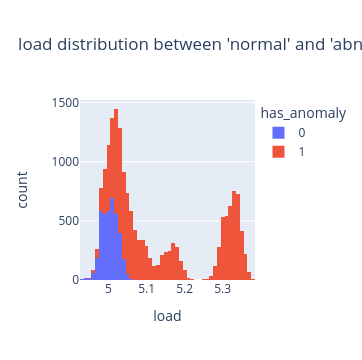

In [4]:
import plotly.express as px
import plotly.subplots 
import kaleido
from IPython.core.display import SVG
import os
## specifically for load
fig = px.histogram( df, x='load', color='has_anomaly', 
                   title="load distribution between 'normal' and 'abnormal' traffic" )
fig.show()

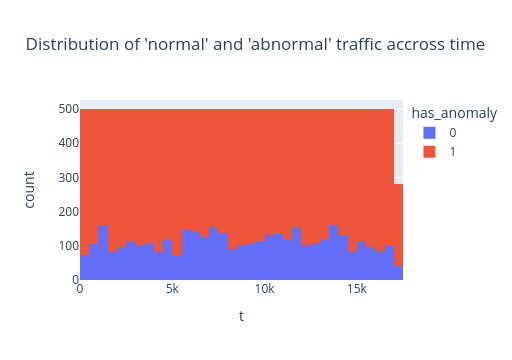

In [5]:
## specifically for time
fig = px.histogram( df, x='t', color='has_anomaly', 
                   title="Distribution of 'normal' and 'abnormal' traffic accross time" )
fig.show()

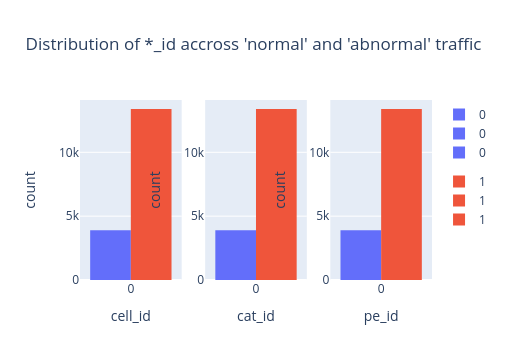

In [6]:
## others
subfig_list = [px.histogram( df, x=feature, color='has_anomaly' ) for feature in [ 'cell_id', 'cat_id', 'pe_id' ] ]

fig = plotly.subplots.make_subplots( rows=1, cols=len(subfig_list) )
for subfig in subfig_list :  
  xaxis_title_text = subfig[ 'layout' ][ 'xaxis' ][ 'title' ][ 'text' ]
  yaxis_title_text = subfig[ 'layout' ][ 'yaxis' ][ 'title' ][ 'text' ]
  col = subfig_list.index( subfig ) + 1    
  for trace in range(len(subfig["data"])):
    fig.add_trace( subfig["data"][trace], row=1, col= col )
    fig.update_xaxes( title_text=xaxis_title_text, row=1, col=col )
    fig.update_yaxes( title_text=yaxis_title_text, row=1, col=col )
fig.update_layout(title_text="Distribution of *_id accross 'normal' and 'abnormal' traffic")
fig.show() 

## PCA

The analysis of the feature distribution reveals that relying solely on the 'load' feature is insufficient to determine whether a measurement is 'abnormal' or not. It suggests that considering the element of time might be beneficial in this regard. In this section, our objective is to examine the correlation between time and load, and explore if there exists a more effective way to represent the data.

Even after normalizing the components, plotting the various measurements in a 'load', 't' space does not exhibit a distinct separation between abnormal and normal measurements.

Principal Component Analysis (PCA) is employed to capture the variance or information carried by each feature. However, since time differs for each measurement, it encompasses all the variance, which in our case does not provide significant information. If we suspected certain patterns, such as specific days of the week, we could have adjusted the 't' feature to highlight these days. Consequently, the PCA measurements are merely presented as an example.

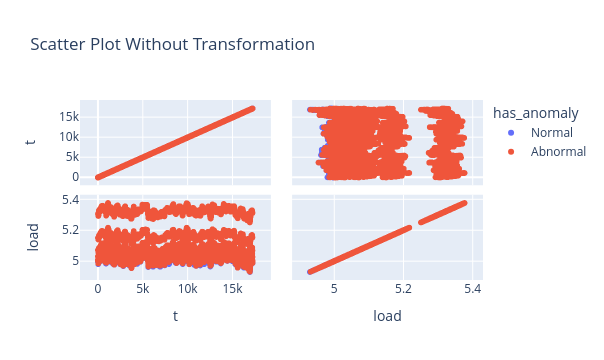

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
from sklearn.preprocessing import StandardScaler 
from sklearn.decomposition import PCA
import numpy as np

df = pd.read_csv( 'nwdaf_data.csv' )
df = df[ ( df.cell_id == 0 ) & ( df.cat_id == 0 ) & ( df.pe_id == 0 ) ] 
df[ 'has_anomaly' ] = df[ 'has_anomaly' ].map( { 0: 'Normal', 1: 'Abnormal' } )
#print( df )
## removing columns
X = df[ ['t', 'load'] ]

#Target = df[ [ 'has_anomaly' ] ][ 'has_anomaly'].map( { 0: 'Normal', 1: 'Abnormal' } )


fig = px.scatter_matrix(df,
    dimensions=X.columns,
    color="has_anomaly", title="Scatter Plot Without Transformation")
fig.show()

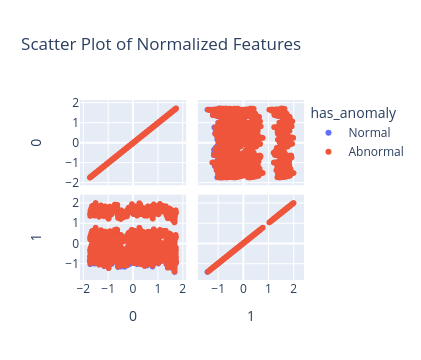

In [8]:
Target = df[ 'has_anomaly' ]
x_scaled = StandardScaler().fit_transform(X)
scaled_df = pd.DataFrame.from_records( x_scaled )
scaled_df[ 'has_anomaly' ] = Target.to_list()
fig = px.scatter_matrix(scaled_df,
    dimensions=[ 0, 1],
    color="has_anomaly", title="Scatter Plot of Normalized Features")
fig.show()

PCA Components (~base): [[ 1.00000000e+00 -4.85702041e-07]
 [ 4.85702041e-07  1.00000000e+00]]
PCA Explained Variance (~length): [2.4884640e+07 1.7136686e-02]
PCA Explained Variance ratio: [9.99999999e-01 6.88645124e-10]


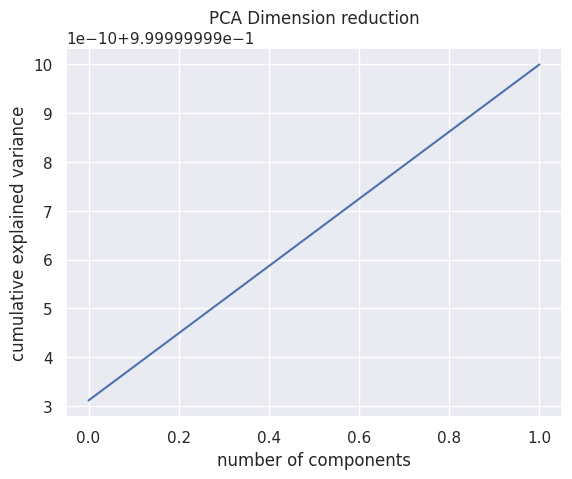

In [9]:
#def characterize_pca( X, filename="" ):
X = df[ ['t', 'load'] ]
pca = PCA(n_components = len( X.columns ) )
pca.fit( X ) # scaling
X_pca = pca.transform(X)
print(f"PCA Components (~base): {pca.components_}")
print(f"PCA Explained Variance (~length): {pca.explained_variance_}")
print(f"PCA Explained Variance ratio: {pca.explained_variance_ratio_}")

plt.plot(np.cumsum(pca.explained_variance_ratio_) )
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title( "PCA Dimension reduction" )
plt.show()

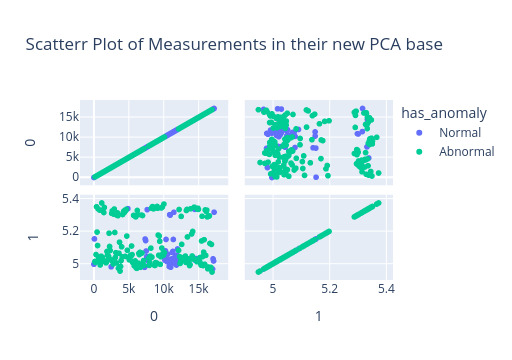

In [10]:
X_new = pca.inverse_transform(X_pca)
#print( X_new )
new_df = pd.DataFrame.from_records( X_new )
dim = new_df.columns
new_df[ 'has_anomaly' ] = Target

#print( new_df.head ) 
fig = px.scatter_matrix(new_df,
    dimensions=dim,
    color="has_anomaly", title="Scatterr Plot of Measurements in their new PCA base")
fig.show()

# Definition of our Forecasting/Classification System

In our scenario, our objective is to develop a system that can anticipate whether the upcoming 'steps' in ongoing traffic will be 'abnormal' or 'normal'. This system can be divided into two distinct operations:
1. A forecasting component that can generate a prediction $p$
2. A classification component that can determine whether the prediction $p$ is 'abnormal' or 'normal'.

The diagram below illustrates the architecture of our system. The input consists of a Time Series, where each time point $t$ is associated with a label ('abnormal' / 'normal') and an exogenous data value ('exog'). The label is represented by two distinct values and is encoded as $0$ or $1$. It is worth noting that it is common practice to limit the Time Series to only the sequence of labels or its numerical representation without including exogenous data. Therefore, we will evaluate the performance of the Forecaster both with and without exogenous data. In forecasting, we typically rely on past data, but it is also common to issue predictions by considering only the most recent observed values instead of all the data collected over time. The number of previous measurements used for prediction is referred to as the 'lag'. This parameter needs to be estimated carefully to strike a balance between learning, prediction, and the accuracy of the forecasts.

The Forecaster generates a series of labels ahead of time. Since the prediction depends on previous label values, any error that occurs at time 't' will be propagated to all subsequent predictions. In other words, the accuracy of the predictions is expected to decrease gradually. Similar to the 'lag' parameter, we will define the 'step', which represents the number of predictions that can be reasonably considered.

The Forecaster is characterized by its ability to produce a range of values between 0 and 1, rather than just 0 or 1. These values can be seen as probabilities of having a "1," which represents abnormal traffic. In order to classify traffic as abnormal, we must establish a threshold value that identifies values above it as abnormal. This concept is illustrated in the figure as the Classifier.

```
Time Serie:
label 'abnormal'    'normal'              'abnormal'
y     1             0              ...     0     
t     0 - lag + 1,  0 - lag + 2    ...     0  
exog: 45            23             ...     5
                          |
                          v                     
 +--------------------------------------------------+
 |                    Forecaster                    |
 +--------------------------------------------------+
                          |
                          v
Predictions:
y    0.003          0.72    ...  0.55
t     1,            2       ...  step  
                          |
                          v                          
 +--------------------------------------------------+
 |                    Classifier                    |
 +--------------------------------------------------+
                          |
                          v                                  
Predictions/Classification:
y    'abnormal'    'normal' ... 'abnormal'
t     1,            2       ...  step  
```

# Measuring the Performance of a Forecaster/Classifier

Measuring the performance of a forecaster/classifier can be a complex task. One challenge is finding the right balance between minimizing false positives (measurements detected as 'abnormal' but are actually 'normal') and correctly identifying abnormal measurements. The choice depends on the desired outcome of the model.

Alternatively, we can assess the overall performance of a model compared to a random model. This can be done by calculating the Area Under the Curve (AUC) using either a Receiver Operating Characteristic (ROC) curve or a Precision-Recall curve.

If you are interested in learning more about ROC curves and Precision-Recall curves for classification in Python, you can refer to the article "How to Use ROC Curves and Precision-Recall Curves for Classification in Python" (https://machinelearningmastery.com/roc-curves-and-precision-recall-curves-for-classification-in-python/). It provides a comprehensive introduction to these concepts. In this section, we will provide a summary of how to apply these techniques in our specific case.


## Forecaster: ROC Curves and ROC AUC

Our scenario involves a binary classification problem where each observation is labeled as either 'normal' or 'abnormal', with the goal of predicting 'abnormal'. The classification outcomes can be categorized as follows:
- When a 'normal' observation is correctly classified as 'normal', it is referred to as a __True Negative__.
- If a 'normal' observation is incorrectly classified as 'abnormal', it is known as a __False Positive__.
- When an 'abnormal' observation is correctly classified as 'abnormal', it is termed as a __True Positive__.
- If an 'abnormal' observation is mistakenly classified as 'normal', it is labeled as a __False Negative__.

The terms False Negative and True Positive are contingent on the target prediction. In our context, the focus is on predicting 'abnormal'. However, if the objective were to predict 'normal', the roles of Positive and Negative would be reversed. Furthermore, in a scenario where the goal is to differentiate between 'apple' and 'banana', the concepts of Positive and Negative may not be applicable.

Therefore, the distinction between True / False is linked to the prediction itself, while Positive / Negative is associated with whether we are predicting 'abnormal' (Positive) or 'normal' (Negative).

We hereby establish the subsequent rates:

Sensitivity (or True Positive Rate) indicates how accurately the models anticipates the occurrence of an event among all correct predictions. In this scenario, it refers to the 'abnormal' measurements predicted as 'abnormal' out of all 'abnormal' measurements (predicted as 'abnormal' or 'normal').
$$Sensitivity = \frac{True\; Positive}{True\; Positive + False\; Negative}$$

False Alarm Rate (or False Positive Rate) signifies how frequently an event is forecasted when it does not transpire. In our case, it represents the quantity of 'normal' measurements predicted as 'abnormal' over the total 'normal' measurements (predicted as 'abnormal' or 'normal').
$$False\; Positive\; Rate = \frac{False\; Positives}{False\; Positives + True\; Negatives}$$

Specificity acts as a counterpart to the False Positive Rate. In this context, it denotes the count of 'normal' measurements predicted as 'normal' out of all 'normal' measurements (predicted as 'abnormal' or 'normal').
$$Specificity = 1 - False\; Positive\; Rate$$
$$Specificity = \frac{True\; Negative}{False\; Positives + True\; Negatives}$$

Receiver Operating Characteristic (ROC) curves illustrate the True Positive Rate (y-axis) versus False Positive Rate (x-axis). The y-axis indicates the likelihood of correctly predicting 'abnormal' traffic, while the x-axis represents the model's capability to predict 'abnormal' when it is actually normal. By establishing an acceptable False Positive rate (and permitting false alarms), we can identify more True Positives. In our scenario, the False Positive Rate indicates the extent to which 'normal' measurements may be identified as 'abnormal'. The trade-off is that more 'abnormal' traffic may be incorrectly labeled as 'abnormal'.

Ideally, we aim for all 'abnormal' measurements to be classified as 'abnormal' (True Positive = 1) and no 'normal' measurements to be classified as 'abnormal'. However, we operate in a non-ideal environment, and the ROC demonstrates that approximately 2 False Positives are incurred for each additional True Positive.

Since achieving all True Positives and no False Positives is unattainable, we must determine what is acceptable in our situation and configure the model accordingly. Essentially, this involves examining all parameters, evaluating the resulting True Positives and False Positives for each configuration, and then plotting the ROC curve. These parameters (referred to as `rf_probs` in the code below) are supplied through the `predict_and_proba` function.

```
## creation of the model
classifier = sklearn.ensemble.RandomForestClassifier(\
                  random_state=123,
                  n_estimators=100,
                  max_depth=10 )
## training the model
classifier.fit( X=trainX , y=trainy ) 
rf_probs = classifier.predict_proba( testX )
## computing the False Positive Rate and True Positive Rate 
## for all parameters.
rf_fpr, rf_tpr, rf_threshold = sklearn.metrics.roc_curve(testy, rf_probs)
```

The primary distinction between `predict` and `predict_and_proba` lies in the fact that `predict` is designed to output the predicted class for each test input, while `predict_and_proba` provides the model's confidence in its prediction. This confidence is expressed in terms of probability.
[What Is The Difference Between predict() and predict_proba() in scikit-learn?](https://towardsdatascience.com/predict-vs-predict-proba-scikit-learn-bdc45daa5972), [Difference between predict and predict_proba in Sklearn](https://www.educative.io/answers/difference-between-predict-and-predictproba-in-sklearn). 


The [roc_curve](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html#sklearn.metrics.roc_curve) function requires the probabilities (`rf_probs`) and true values (`testy`) as inputs. It determines a threshold to assign a class to each test based on the probability. For each threshold, it calculates the True Positive Rate and False Positive Rate.

On the other hand, the [roc_auc_score](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_auc_score.html#sklearn.metrics.roc_auc_score) function calculates the AUC by generating ROC curves and computing the area between the No Skill line and the classifier-generated line. This value represents the model's performance across all possible thresholds.

It is important to note that the classifier includes a [score](https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html#sklearn.ensemble.RandomForestClassifier.score) function that gives the average accuracy across all labels. Since we have two labels in this case, the score is likely to be the average accuracy.

In [17]:
import os
import time_series_utils as tu
from IPython.core.display import SVG
import sklearn.ensemble

import matplotlib.pyplot as plt

# roc curve and auc
#from sklearn.datasets import make_classification
#from sklearn.linear_model import LogisticRegression
import sklearn.ensemble
import sklearn.metrics 

#from sklearn.model_selection import train_test_split
#from sklearn.metrics import roc_curve
#from sklearn.metrics import roc_auc_score

## Selecting aand formating a subset of the data
cell_id=0
cat_id=0 
pe_id=0 

# formating the dataset
data = tu.NWDAFDataSet ( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )

#regressor = sklearn.ensemble.RandomForestRegressor(\
#                  random_state=123,
#                  n_estimators=100,
#                  max_depth=10 )

classifier = sklearn.ensemble.RandomForestClassifier(\
                  random_state=123,
                  n_estimators=100,
                  max_depth=10 )

test_ratio = 20
data_train, data_test = data.get_train_test( test_ratio )

trainX = data_train.drop( columns=[ 'y' ] )
trainy = data_train[ 'y' ]

classifier.fit( X=trainX , y=trainy ) 

# generate a no skill prediction (majority class)
ns_probs = [0 for _ in range(len(data_test))]
testX = data_test.drop( columns=[ 'y' ] )
testy = data_test[ 'y' ]

# predict probabilities
rf_probs = classifier.predict_proba( testX )
rf_predictions = classifier.predict( testX )
print( "Comparing predict and predict_and_proba:" )
print( f"  -- predict: {rf_predictions}" )
print( f"  -- predict and proba: {rf_probs}" )
# keep probabilities for the positive outcome only
rf_probs = rf_probs[:, 1]

# calculate AUC
ns_auc = sklearn.metrics.roc_auc_score( testy, ns_probs)
rf_auc = sklearn.metrics.roc_auc_score( testy, rf_probs)
print( f"\nComputing ROC AUC" )
print('  - No Skill: ROC AUC=%.3f' % (ns_auc))
print('  - RandomForest: ROC AUC=%.3f\n' % (rf_auc))
print( f"  - score: {classifier.score( X=testX , y=testy )}"  ) 

# calculate roc curves
ns_fpr, ns_tpr, _ = sklearn.metrics.roc_curve(testy, ns_probs)
rf_fpr, rf_tpr, rf_thresholds = sklearn.metrics.roc_curve(testy, rf_probs)
print( f"Random Forest False Positive Rate: {rf_fpr[:5]}..." )
print( f"Random Forest True Positive Rate: {rf_tpr[:5]}..." )
print( f"Random Forest Thresholds: {rf_thresholds[:5]}..." )


# plot the roc curve for the model
plt.plot(ns_fpr, ns_tpr, linestyle='--', label='No Skill')
plt.plot(rf_fpr, rf_tpr, marker='.', label='RandomForest')
# axis labels
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend
plt.legend()
plt.tight_layout()

# show the plot
svg_fn = os.path.join( './', "ROC_curve_randomforest_classifier.svg" )
plt.savefig(svg_fn)
plt.close()
tu.show_svg(svg_fn, width="50%")

Comparing predict and predict_and_proba:
  -- predict: [1 1 1 ... 0 0 0]
  -- predict and proba: [[0.   1.  ]
 [0.   1.  ]
 [0.   1.  ]
 ...
 [0.86 0.14]
 [0.86 0.14]
 [0.86 0.14]]

Computing ROC AUC
  - No Skill: ROC AUC=0.500
  - RandomForest: ROC AUC=0.863

  - score: 0.8177867902665121
Random Forest False Positive Rate: [0.         0.06922285 0.30725682 0.32012352 0.50437468]...
Random Forest True Positive Rate: [0.         0.72857784 0.85471811 0.85965306 0.91326454]...
Random Forest Thresholds: [ inf 1.   0.99 0.98 0.97]...


As ROC curves are very common, sklearn provides various ways to build it in one line using [RocCurveDisplay](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.RocCurveDisplay.html#sklearn.metrics.RocCurveDisplay.from_estimator)

Similarly, we can also plot it using [plotly](https://plotly.com/python/roc-and-pr-curves/). I do prefer plotly as it enables interactions. 

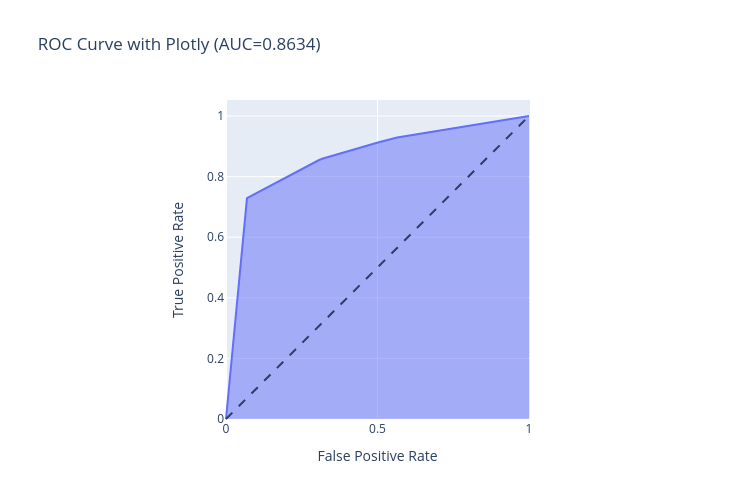

In [18]:
import plotly.express as px

rf_fpr, rf_tpr, rf_thresholds = sklearn.metrics.roc_curve(testy, rf_probs)
auc = sklearn.metrics.auc(rf_fpr, rf_tpr)

fig = px.area(
    x=rf_fpr, y=rf_tpr,
    title=f'ROC Curve with Plotly (AUC={auc:.4f})',
    labels=dict(x='False Positive Rate', y='True Positive Rate'),
    width=700, height=500
)
fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=0, y1=1
)
fig.update_yaxes(scaleanchor="x", scaleratio=1)
fig.update_xaxes(constrain='domain')
fig.show()

svg_fn = "ROC_curve_using_RocCurveDisplay.svg"
if os.path.isfile( svg_fn ) is False:
  fig, ax = plt.subplots(figsize=(12, 4), nrows=1, ncols=3 )
  disp = sklearn.metrics.RocCurveDisplay(fpr=rf_fpr, tpr=rf_tpr, roc_auc=rf_auc,
                                         estimator_name='Random Forest Estimator' )
  disp.plot( ax=ax[ 0 ] )
  ax[ 0 ].set_title( "RocCurveDisplay" )
  disp = sklearn.metrics.RocCurveDisplay.from_predictions(testy, rf_predictions )
  disp.plot( ax=ax[ 1 ] )
  ax[ 1 ].set_title( "from_predictions" )
  disp  = sklearn.metrics.RocCurveDisplay.from_estimator( classifier, testX, testy )
  disp.plot( ax=ax[ 2 ] )
  ax[ 2 ].set_title( "from_estimator" )
  fig.suptitle("ROC Curves with RocCurveDisplay" )  
  plt.tight_layout()
  fig.savefig( svg_fn )
  plt.close( fig )
  #plt.show()

tu.show_svg("ROC_curve_using_RocCurveDisplay.svg" )

## Forecaster Precision-Recall Curves and Precision-Recall AUC

Precision represents the ratio of True Positives to all Positive predictions. It indicates how confident we can be that a measurement classified as 'abnormal' is truly 'abnormal'.
$$Precision = \frac{True\; Positives}{True\; Positives + False\; Positives}$$

This metric differs from the True Positive Rate, which focuses on the accurate classification of 'abnormal' measurements. The True Positive Rate is determined before the classifier runs, while Precision is defined after the classifier has made its predictions.

Recall, also known as Sensitivity, measures the effectiveness of the classification in identifying the target. In this context, Recall indicates the proportion of 'abnormal' instances that are correctly classified as 'abnormal' over all instances classified as 'abnormal' (both 'abnormal' and 'normal').

$$Recall = \frac{True\; Positives}{True Positives + False Negatives}$$

Precision-Recall curves are particularly useful when dealing with imbalanced data, as they are less affected by skewed class distributions.

In our scenario, where the measurements are unbalanced, the Precision-Recall function may provide more relevant insights.

Ideally, we aim for a classifier with high reliability, reflected in a Precision of 1 (no False Positives) and a Recall of 1 (no False Negatives). However, there is a trade-off between Precision and Recall, meaning that increasing one typically leads to a decrease in the other.

In [19]:
# predict class values
predictions = classifier.predict(testX)
print( "Comparing predict and predict_and_proba:" )
print( f"  - Predictions (predict): {predictions[:10]}...")
print( f"  - Predictions (predict_and_proba): {rf_probs[:10]}...\n")

rf_precision, rf_recall, rf_threshold = sklearn.metrics.precision_recall_curve(testy, rf_probs)
print( "Displaying precision and recall:" )
print( f"  - Random Forest precision: {rf_precision[:10]}..." )
print( f"  - Random Forest Recall: {rf_recall[:10]}...\n" )

print( f"Computing Recal-Precision AUC" )
rf_auc = sklearn.metrics.auc(rf_recall, rf_precision)
print('  - RandomForest: auc=%.3f\n' % (rf_auc))

# plot the precision-recall curves
no_skill = len(testy[testy==1]) / len(testy)
plt.plot([0, 1], [no_skill, no_skill], linestyle='--', label='No Skill')
plt.plot(rf_recall, rf_precision, marker='.', label='RandomForest')
# axis labels
plt.xlabel('Recall')
plt.ylabel('Precision')
# show the legend
plt.legend()
# show the plot
# show the plot
svg_fn = os.path.join( './', "ROC_PR_curve_randomforest_classifier.svg" )
plt.savefig(svg_fn)
plt.close()
tu.show_svg(svg_fn, width="50%")

Comparing predict and predict_and_proba:
  - Predictions (predict): [1 1 1 1 1 1 1 1 1 1]...
  - Predictions (predict_and_proba): [1.   1.   1.   1.   1.   1.   0.99 0.99 0.97 0.97]...

Displaying precision and recall:
  - Random Forest precision: [0.77485516 0.84984266 0.85076469 0.85235407 0.85898334 0.8597193
 0.86171864 0.90236245 0.90542574 0.97313492]...
  - Random Forest Recall: [1.         0.92889188 0.92754598 0.925901   0.91730223 0.91603111
 0.91326454 0.85965306 0.85471811 0.72857784]...

Computing Recal-Precision AUC
  - RandomForest: auc=0.960




Similarly to the  ROC Curves, the Precision Recal Curve may be plot using   
[PrecisionRecallDisplay](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.PrecisionRecallDisplay.html#sklearn.metrics.PrecisionRecallDisplay.from_predictions) or [plotly](https://plotly.com/python/roc-and-pr-curves/).


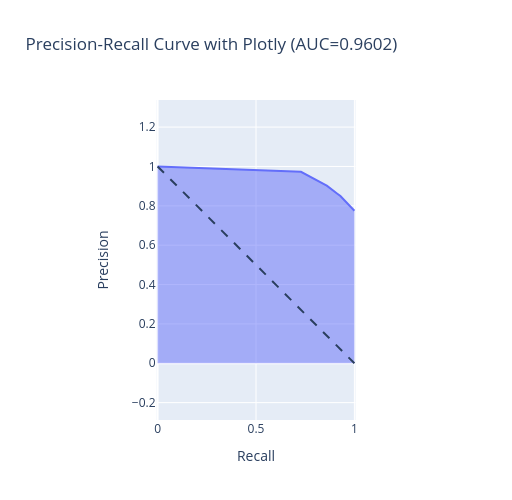

In [23]:




rf_precision, rf_recall, rf_threshold = sklearn.metrics.precision_recall_curve(testy, rf_probs)
rf_auc = sklearn.metrics.auc(rf_recall, rf_precision)

fig = px.area(
    x=rf_recall, y=rf_precision,
    title=f'Precision-Recall Curve with Plotly (AUC={rf_auc:.4f})',
    labels=dict(x='Recall', y='Precision'),
    width=700, height=500
)
fig.add_shape(
    type='line', line=dict(dash='dash'),
    x0=0, x1=1, y0=1, y1=0
)
fig.update_yaxes(scaleanchor="x", scaleratio=1)
fig.update_xaxes(constrain='domain')

fig.show()
# show the plot

svg_fn = "PrecisionRecallDisplay_randomforest_classifier.svg"
if os.path.isfile( svg_fn ) is False:
  fig, ax = plt.subplots(figsize=(12, 4), nrows=1, ncols=3 )
  disp =  sklearn.metrics.PrecisionRecallDisplay(precision=rf_precision, recall=rf_recall )
  ax[ 0 ].set_title( "PrecisionRecallDisplay") 
  disp.plot( ax=ax[ 0 ] )
  disp = sklearn.metrics.PrecisionRecallDisplay.from_predictions(testy, predictions )
  ax[ 1 ].set_title( "from_predictions" )
  disp.plot( ax=ax[ 1 ] )
  disp = sklearn.metrics.PrecisionRecallDisplay.from_estimator( classifier, testX, testy )
  ax[ 2 ].set_title( "from_predictions" )
  disp.plot( ax=ax[ 2 ] )
  fig.suptitle("Precision Recall ROC Curves with PrecisionRecallDisplay" )  
  plt.tight_layout()
  fig.savefig( svg_fn )
  plt.close( fig )
tu.show_svg(svg_fn )      

## Illustration to our Forecaster

Now that we have comprehended how to assess probabilistic models on a global scale (regardless of the threshold), let's delve into the application of the AUC in the context of time prediction, which is crucial for forecasters.

The scenario differs slightly with the RandomForest model, where the classifier is trained using `trainX` and `trainy`. To assess the classifier, we input `testX`, and the classifier produces a prediction. This prediction can represent a probability for each tested element, enabling us to construct an ROC or Precision-Recall curve. Evaluating True/False Positive/Negative Rates becomes more precise with a higher number of values from `testX` since these rates are directly calculated by comparing the predictions with actual values (`testy`). The position of a measurement in `testX` should not influence the prediction.

Forecasters, on the other hand, aim to predict the next `steps` based on training data `trainy`. Initially, a forecaster relies solely on time to discern whether the traffic is 'normal' or 'abnormal'. As the number of `steps` to predict increases, errors are bound to occur, particularly when the predicted steps guide subsequent predictions. Going too far may lead to the most frequent occurrence of 'normal' or 'abnormal'. Considering we have a higher occurrence of 'abnormal,' when predictions become unattainable, the best guess is 'abnormal.' This marks the juncture where predictions on an extensive number of steps converge. Consequently, possessing a vast `testX` (or actually `testy`) dataset may reduce discrepancies among various forecasters.

The forecaster observes the `trainX` as a sequence of '0' and '1', and it will analyze the recurrence of these events over the previous `lag` steps. The forecaster does not interpret these '0' and '1' as categories, but rather as numerical values. The predictions can be seen as probabilities of taking the value '1'. This is the perspective from which we will consider these predictions.

There are several questions that we aim to address:
1. What is the model's performance?
2. How many lag steps does the model require for prediction?
3. How many steps ahead can the model predict?

To evaluate the model's performance, we will use the AUC metric for different `lag` values and a limited number of `testy` instances. The number of `testy` instances will be determined to be just sufficient to exhaust the prediction, meaning that in our case, it will always predict 'abnormal'. The optimal `lag` value is the one that maximizes the AUC or the one beyond which increasing the value does not significantly improve the AUC. In other words, the additional benefit gained from increasing the `lag` value does not justify the extra computational effort required.

Long Term Prediction:
  - 'abnormal': 77.0616%
  - 'normal': 22.9384%
 predictions: 2024-01-01 04:46:20    1.0
2024-01-01 04:46:21    1.0
2024-01-01 04:46:22    1.0
2024-01-01 04:46:23    1.0
2024-01-01 04:46:24    1.0
                      ... 
2024-01-01 04:47:55    1.0
2024-01-01 04:47:56    1.0
2024-01-01 04:47:57    1.0
2024-01-01 04:47:58    1.0
2024-01-01 04:47:59    1.0
Freq: S, Name: pred, Length: 100, dtype: float64
Displaying precision and recall:
  - Random Forest precision: [0.79253472 0.79247467 0.79270411 0.79264408 0.79258401 0.79252391
 0.79275362 0.79298347 0.79321346 0.79315347]...
  - Random Forest Recall: [1.         0.9996349  0.9996349  0.99926981 0.99890471 0.99853961
 0.99853961 0.99853961 0.99853961 0.99817452]...

Computing AUC
  - Precision-Recall AUC: 0.8890
  - ROC AUC: 0.5662


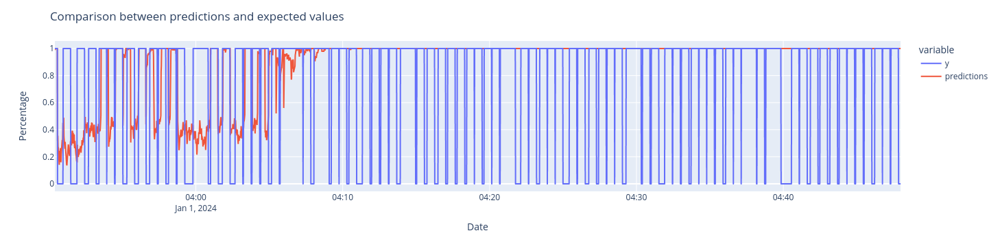

In [24]:
#import skforecast.ForecasterAutoreg
import plotly.express as px
import sklearn
import skforecast
import time_series_utils as tu
#from IPython.core.display import SVG

cell_id=0
cat_id=0 
pe_id=0 

# formating the dataset
data = tu.NWDAFDataSet ( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )

train_len = int( 80 * len( data.df ) / 100 )  
data_train, data_test = data.get_train_test( train_len )

#trainX = data_train.drop( columns=[ 'y' ] )
trainy = data_train[ 'y' ]
print( f"Long Term Prediction:" )
print( f"  - 'abnormal': {len( trainy[ trainy==1 ] ) / len( trainy ) * 100:.4f}%" )
print( f"  - 'normal': {len( trainy[ trainy==0 ] ) / len( trainy ) * 100:.4f}%" )

#testX = data_test.drop( columns=[ 'y' ] )
testy = data_test[ 'y' ]

regressor = sklearn.ensemble.RandomForestRegressor(\
                  random_state=123,
                  n_estimators=100,
                  max_depth=10 )
lag = 400
forecaster = skforecast.ForecasterAutoreg.ForecasterAutoreg(
                   regressor = regressor,
                   lags      = lag
               )

#print( f"trainy: {trainy[ -100 : ] }" )
forecaster.fit( y=trainy )

steps =  int( 1 * len( testy ) )

if steps >  len( testy ) :
  raise ValueError( f"steps {steps} is too high. Must be lower than {len( testy )}" ) 

f_predictions = forecaster.predict( steps=steps )
#print( f"  - Predictions (predict): {f_predictions[:10]}...")

f_precision, f_recall, f_threshold = sklearn.metrics.precision_recall_curve(testy[ : steps ], f_predictions )
print( f" predictions: {f_predictions[-100:]}" ) 
print( "Displaying precision and recall:" )
print( f"  - Random Forest precision: {f_precision[:10]}..." )
print( f"  - Random Forest Recall: {f_recall[:10]}...\n" )

print( "Computing AUC" )
print(f"  - Precision-Recall AUC: {sklearn.metrics.auc(f_recall, f_precision):.4f}")
print(f"  - ROC AUC: {sklearn.metrics.roc_auc_score( testy[ : steps ], f_predictions):.4f}")

fig = px.line( testy[ : steps ] ) 
#fig = px.line( tu_predictions[ : steps ] ) 
fig.add_scatter(x=f_predictions.index[ : steps ], y=f_predictions[ : steps ],name='predictions' )
#fig.add_scatter(x=tu_predictions.index[ : steps ], y=tu_predictions[ : steps ] )
fig.update_layout( 
    title='Comparison between predictions and expected values',
    xaxis_title='Date',
    yaxis_title='Percentage')
fig.show()


## Classifier: Performance with F1 Score 

In our scenario, the forecaster inputs a value between 0 and 1, which is interpreted as a probability. By setting a threshold, we can assign the corresponding probability to either class '0' or '1'. In this context, class '1' represents the 'abnormal' class, while class '0' represents the 'normal' class. ROC AUC and PR AUC are advantageous because they can be computed based on probabilities rather than specific class assignments, thus avoiding dependency on the threshold value. Additional metrics to be considered are those that focus on the precise classification of 'normal' or 'abnormal' classes. Some of these metrics can be found in the [sklearn.metrics](https://scikit-learn.org/stable/modules/model_evaluation.html) library.

F1 score, which is the harmonic mean of recall and precision, is chosen as the primary metric for evaluating the models.

$$ F1 = \frac{2}{recall^{-1} + precision^{-1}} $$ 
$$ F1 = \frac{2 * TP}{2 * TP + FP + FN} $$ 

F1 score has two variations: 'binary' and 'micro'. When 'binary' is selected, the focus is solely on predicting 'abnormal' instances. This means that only true positives (TP) are considered for instances predicted as 'abnormal' and actually are 'abnormal'. On the other hand, with 'micro' variation, TP includes both instances predicted as 'abnormal' and actually are 'abnormal', as well as instances predicted as 'normal' and are 'normal'.

There are other F1 score variants that address unbalanced datasets, but they are not discussed here.

After obtaining an appropriate F1 score, we analyze each component separately to assess the model's performance. Similar to F1 score, recall and precision have 'binary' and 'micro' variations that we take into account.

Accuracy indicates the proportion of correctly predicted instances.


# Selecting a Single Serie Forecaster/Classifier

In the remainder of this section, we will compare different forecasters, namely Autoreg and AutoregWithExog, each combined with two different regressors: a RandomForest regressor and Ridge, a linear regressor.

Our objective is to determine the appropriate number of lags to be used by the forecaster and evaluate their performances accordingly. The number of lags is chosen as a compromise between achieving the highest PR AUC and ensuring that the fitting time does not exceed 60 seconds.

The fit and prediction time represents the duration required to train or predict the train_test dataset using the model. These time measurements are conducted on the same computer (Intel NUC), although we cannot guarantee identical load conditions. Variations in performance may arise from a combination of underperforming model computations due to random choices and differences in the load on the NUC.

When seeking an optimal value, it is important for these values to remain relatively stable as the context evolves. In this regard, we consider that the selected lag should yield similar metrics even when the number of lags varies. We assume that a change in lag could reflect a change in the context.

The PR AUC is our primary metric for evaluating the performance of the model. It indicates how much better the model performs compared to random predictions. 

With the exception of AutoregWithExog / Ridge, the PR AUC tends to remain relatively constant with some fluctuations. In these cases, we select parameters that enhance the stability of the prediction. In other words, we aim to minimize the impact of small changes on the prediction. One such change is the variation of lag, and we handle it as follows:

We divide the lag into windows of 100 lags each. For each window, we calculate the AUC for each individual lag and then determine the L∞ distance, which measures the variation of the PR AUC across the lag window. We sort these variations and choose the windows with the smallest variation, as long as the computation time remains below 60 seconds. The selected lag is the one at the center of the chosen window.

Once the lag is selected, we define the Forecaster and display the associated measurements, including scores from various metrics. Similarly, we only consider metrics that demonstrate stability, and we consider metrics as non-applicable when the distance is too high.

The performance of AutoregWithExog / Ridge model is influenced by the number of lags. The PR AUC decreases as the number of lags increases, so it is important to find a balance between stability and PR AUC performance. When the number of lags is greater than 850, the variations in PAR AUC become more stable, but the PR AUC values are low. 

In the randomforest case, the optimal PR AUC is achieved with 1502 lags, resulting in a mean value of 0.81 and L∞=0.00. However, it is expected to have PR AUC values greater than 0.9 with fewer than 500 lags. 

Furthermore, when the number of lags exceeds 750, the optimum scores are significantly lower compared to a number of lags below 500 (e.g., 0.3 versus 0.8 for f1 binary). However, the optimum threshold values are not stable, and further studies are required to understand the impact of threshold variations on the scores or PR AUC. 

Therefore, to apply the previous method, we limit the acceptable lag values to [0, 250]. 

The performance results for the Forecaster / Regressor are summarized below:

| Forcaster / Regressor | Autoreg / RandForest     | A. WithExog / RF | Autoreg / Ridge | A. WithExog / Ridge    |
|-----------------------|--------------------------|------------------|-----------------|------------------------|
| optimum lag           | 1404                     | 94               | 1722            | 196                    |
| optimum PR AUC:       | ~=0.87, L∞=0.04          | ~=0.95, L∞=0.02  | ~=0.79, L∞=0.00 | ~=0.96, L∞=0.00        |
| selected_lag:         | 412 +/- 100              | 94 +/- 100       | 1722 +/- 100    | 196 +/- 100            |
| model size (bytes)    |                 | 94 +/- 100       | 1722 +/- 100    | 196 +/- 100            |
| predition time (s)    | ~=38.95, L∞=31.31        | ~=41.77, L∞=41.16| ~=1.03, L∞=4.29 | ~=1.54, L∞=6.01        |
| fit time (s)          | ~=51.97, L∞=44.48, coef=0.15 s/lag | ~=10.69, L∞=18.50, coef=0.09 s/lag | ~=8.26, L∞=9.92, coef=-0.002 s/lag |  ~=0.59, L∞=2.47, coef=0.00 s/lag |
| PR AUC                | ~=0.87, L∞=0.07          | ~=0.95, L∞=0.02  | ~=0.79, L∞=0.00 |  ~=0.96, L∞=0.00       |
| Mean Square Error     | ~=0.22, L∞=0.08          | ~=0.17, L∞=0.03  | ~=0.17, L∞=0.00 | ~=0.13, L∞=0.00        |
| Mean Absolute Error   | ~=0.28, L∞=0.19          | ~=0.19, L∞=0.03  | ~=0.34, L∞=0.00 | ~=0.31, L∞=0.01        |
| R2 Score              | ~=-0.35, L∞=0.47         | ~=-0.05, L∞=0.18 | ~=-0.04, L∞=0.01| ~=0.18, L∞=0.02        |
| steps Prediction      | 530.00                   | 3455.00 steps    | 3455.00 steps   | 3455.00 steps          |
| f1_binary (Score)     | ~=0.88, L∞=0.00          | ~=0.88, L∞=0.01  | ~=0.88, L∞=0.00 | ~=0.75, L∞=0.04        |
| f1_binary (Thres)     | ~=0.13, L∞=0.26          | ~=0.17, L∞=0.97  | ~=0.32, L∞=0.13 | ~=0.40, L∞=0.27        |
| f1_micro (Score)      | ~=0.79, L∞=0.01          | ~=0.79, L∞=0.02  | ~=0.78, L∞=0.01 | ~=0.60, L∞=0.06        |
| f1_micro (Thres)      | ~=0.14, L∞=0.35          | ~=0.18, L∞=0.97  | ~=0.32, L∞=0.13 | ~=0.42, L∞=0.19        |
| accuracy (Score)      | ~=0.79, L∞=0.01          | ~=0.79, L∞=0.02  | ~=0.78, L∞=0.01 | ~=0.60, L∞=0.06        |
| accuracy (Thres)      | ~=0.14, L∞=0.35          | ~=0.18, L∞=0.97  | ~=0.32, L∞=0.13 | ~=0.42, L∞=0.19        |
| precision_binary (Score) | ~=0.82, L∞=0.12       | ~=0.87, L∞=0.21  | ~=0.97, L∞=0.19 | ~=1.00, L∞=0.00        |
| precision_binary (Thres) | ~=0.83, L∞=0.86       | ~=0.53, L∞=0.99  | ~=0.98, L∞=0.24 | ~=0.89, L∞=0.05        |
| precision_micro (Score)  | ~=0.79, L∞=0.01       | ~=0.79, L∞=0.02  | ~=0.78, L∞=0.01 | ~=0.60, L∞=0.06        |
| precision_micro (Thres)  | ~=0.14, L∞=0.35       | ~=0.18, L∞=0.97  | ~=0.32, L∞=0.13 | ~=0.42, L∞=0.19        |
| average_precision_micro (Score) | ~=0.81, L∞=0.03| ~=0.80, L∞=0.03  | ~=0.80, L∞=0.01 | ~=0.86, L∞=0.03        |
| average_precision_micro (Thres) | ~=0.76, L∞=0.86| ~=0.38, L∞=0.99  | ~=0.73, L∞=0.08 | ~=0.70, L∞=0.08        |
| recall_binary (Score) | ~=1.00, L∞=0.00          | ~=1.00, L∞=0.03  | ~=0.99, L∞=0.01 | ~=0.75, L∞=0.06        |
| recall_binary (Thres) | ~=0.12, L∞=0.17          | ~=0.16, L∞=0.97  | ~=0.28, L∞=0.03 | ~=0.25, L∞=0.11        |
| recall_micro (Score)  |~=0.79, L∞=0.01           | ~=0.79, L∞=0.02  | ~=0.78, L∞=0.01 | ~=0.60, L∞=0.06        |          | recall_micro (Thres)  |~=0.14, L∞=0.35           | ~=0.18, L∞=0.97  | ~=0.32, L∞=0.13 | ~=0.42, L∞=0.19        |

We have taken into account the stability of the threshold in relation to lag variation. It is assumed that a stable threshold will result in a stable optimal score. However, this assumption has not been explicitly verified and it is possible that a variation in the threshold may not significantly impact the score. While it may not be feasible to check this on every model, we can explicitly examine this on the selected four models. This can be done by plotting the threshold variation from the optimal threshold against the score, where x=(threshold - threshold_optimal) and y=(score - score_optimal).

The prediction of steps is currently being evaluated in a subjective manner, and it would be more appropriate to explicitly measure the scores for various test sets; where x=steps and y=score(test_set[:steps]).

## ForecasterAutoreg / RandomForestRegressor

In [3]:
import time_series_utils as tu
import sklearn
from IPython.core.display import SVG


cell_id=0
cat_id=0 
pe_id=0 

# formating the dataset
data = tu.NWDAFDataSet ( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )
train_len = int( 80 * len( data.df ) / 100 )  
test_len = len( data.df ) - train_len

print( f"test_len : {test_len}" )
regressor = sklearn.ensemble.RandomForestRegressor(\
                  random_state=123,
                  n_estimators=100,
                  max_depth=10 )

forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                          forecaster = 'ForecasterAutoreg')
## plotting AUC, and other performances of the model versus lag
lag_min = 2
lag_max = 2000
lag_step = 2
df_auc, svg = forecaster_eval.plot_lag_forcaster_evaluation( lag_min, lag_max, lag_step )
tu.show_svg( svg )

test_len : 3456
Storing results in cell_id-0--cat_id-0--pe_id-0


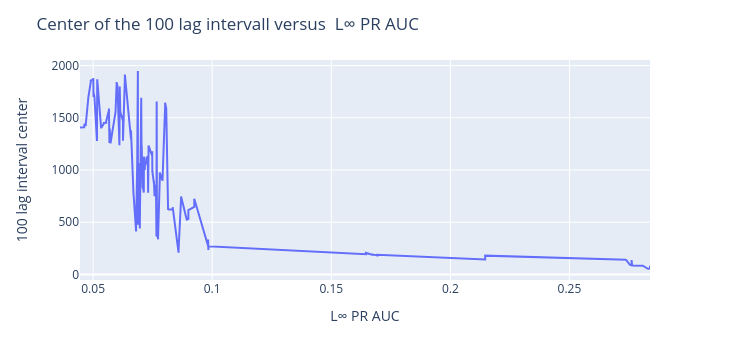

L∞ AUC for 100 lag interval: [(1404, 0.0444930232902323), (1406, 0.0444930232902323), (1408, 0.0444930232902323), (1410, 0.04624537516089111), (1412, 0.04624537516089111), (1414, 0.04624537516089111), (1416, 0.04624537516089111), (1418, 0.04624537516089111), (1420, 0.04624537516089111), (1438, 0.04636914315729246), (1440, 0.04636914315729246), (1442, 0.04636914315729246), (1422, 0.04691484193588302), (1424, 0.04691484193588302), (1426, 0.04691484193588302), (1428, 0.04691484193588302), (1430, 0.04691484193588302), (1432, 0.04691484193588302), (1434, 0.04691484193588302), (1436, 0.04691484193588302)]...
  - optimum lag: 1404
  - optimum PR AUC:  ~=0.87, L∞=0.04
  - selected_lag: 412 +/- 100 -- optimizing PR AUC with fit time < 60
Information for model with lag: 412 +/- 100
  - predition time (s):  ~=38.95, L∞=31.31
  - fit time (s):  ~=51.97, L∞=44.48 -- Coefficient [[0.15129642]] s/lag
  - PR AUC:  ~=0.87, L∞=0.07
  - Mean Square Error :  ~=0.22, L∞=0.08
  - Mean Absolute Error :  ~=0.

In [4]:
## selecting the most appropriated lag minimizing L∞ over selected_lag +/- delta_lag
## In addition, we want the training model to be lower than 60 seconds.
delta_lag = 100
max_fit_time = 60
selected_lag = forecaster_eval.select_lag_from_forcaster_evaluation( \
    df_auc, delta_lag=delta_lag, max_fit_time=max_fit_time)

In [5]:
## plotting scores of the thresholed forecaster
lag_min = 1
lag_max = 800
lag_step = 1
df_score, svg = forecaster_eval.plot_thresholded_forecaster_evaluation( lag_min, lag_max, lag_step )
tu.show_svg( svg )

In [6]:
## displaying the scores associated to the selected lag interval
sub_df_score = df_score[ ( df_score[ 'lag' ] >= selected_lag - delta_lag ) & ( df_score['lag'] <= selected_lag + delta_lag ) ]
print( f"Scores for lags: {selected_lag} +/- {delta_lag}\n" )
forecaster_eval.print_mMm_scores( sub_df_score, threshold_var=0.25, score_var=0.25 )


Scores for lags: 412 +/- 100


Accepted Metrics:
  - recall_binary:[Score:  ~=1.00, L∞=0.00][Threshold:  ~=0.12, L∞=0.17]

Rejected Metrics (Too high variation):
  - f1_binary: [Score:  ~=0.88, L∞=0.00][Threshold:  ~=0.13, L∞=0.26]
  - f1_micro: [Score:  ~=0.79, L∞=0.01][Threshold:  ~=0.14, L∞=0.35]
  - accuracy: [Score:  ~=0.79, L∞=0.01][Threshold:  ~=0.14, L∞=0.35]
  - precision_binary: [Score:  ~=0.82, L∞=0.12][Threshold:  ~=0.83, L∞=0.86]
  - precision_micro: [Score:  ~=0.79, L∞=0.01][Threshold:  ~=0.14, L∞=0.35]
  - average_precision_micro: [Score:  ~=0.81, L∞=0.03][Threshold:  ~=0.76, L∞=0.86]
  - recall_micro: [Score:  ~=0.79, L∞=0.01][Threshold:  ~=0.14, L∞=0.35]



Prediction is consistently performed at a fixed time, whereas the fitting time appears to roughly increase in a linear manner with the number of lags, exhibiting high variations. Our aim is to minimize the number of lags to restrict the fitting time, as the forecaster will be updated regularly.

Due to the unbalanced nature of our data set, we are solely focusing on the PR AUC. For lags less than or equal to 350, the AUC cannot be accurately determined. However, for lags greater than or equal to 350, the PR AUC fluctuates within certain values that allow for quantification. This pattern is also observed in the mean square error, mean absolute error, and the R2 score.

The number of predicted steps displays significant variability. The method we use to calculate the number of predicted steps involves counting the steps where the model deviates by exactly "1". This approach is quite lenient, and it might be more appropriate to consider the line that falls below the predicted steps.

A threshold is considered useful only if it ensures stability in terms of lag and if the optimized metric also remains relatively stable. We seek this stability because we anticipate that traffic patterns may change over time, and variations in lag represent potential differences in the "same" traffic. Metrics such as "precision binary" and "average_precision" yield thresholds with excessive variations, while metrics like "f1_binary", "recall_binary", and "recall_micro" are deemed acceptable.

## ForecasterAutoregWithExog / RandomForestRegressor

In [7]:
## defining the new forecaster to eval 
forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                          forecaster = 'ForecasterAutoregWithExog')
## plotting AUC, and other performances of the model versus lag
lag_min = 2
lag_max = 2000
lag_step = 2
df_auc, svg = forecaster_eval.plot_lag_forcaster_evaluation( lag_min, lag_max, lag_step )
tu.show_svg( svg )

Storing results in cell_id-0--cat_id-0--pe_id-0


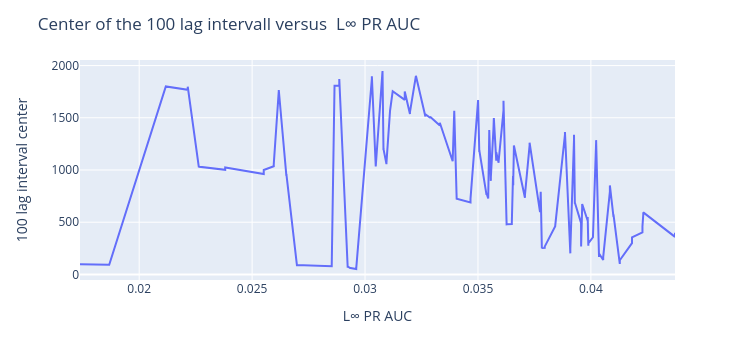

L∞ AUC for 100 lag interval: [(94, 0.01737904533271084), (96, 0.01737904533271084), (98, 0.01737904533271084), (92, 0.018672576592927537), (1800, 0.021179071917753478), (1768, 0.022149741269181566), (1770, 0.022149741269181566), (1772, 0.022149741269181566), (1774, 0.022149741269181566), (1776, 0.022149741269181566), (1778, 0.022149741269181566), (1780, 0.022149741269181566), (1782, 0.022149741269181566), (1784, 0.022149741269181566), (1786, 0.022149741269181566), (1788, 0.022149741269181566), (1790, 0.022149741269181566), (1792, 0.022149741269181566), (1794, 0.022149741269181566), (1796, 0.022149741269181566)]...
  - optimum lag: 94
  - optimum PR AUC:  ~=0.95, L∞=0.02
  - selected_lag: 94 +/- 100 -- optimizing PR AUC with fit time < 60
Information for model with lag: 94 +/- 100
  - predition time (s):  ~=41.77, L∞=41.16
  - fit time (s):  ~=10.69, L∞=18.50 -- Coefficient [[0.09516118]] s/lag
  - PR AUC:  ~=0.95, L∞=0.02
  - Mean Square Error :  ~=0.17, L∞=0.03
  - Mean Absolute Error

In [8]:
## selecting the most appropriated lag minimizing L∞ over selected_lag +/- delta_lag
## In addition, we want the training model to be lower than 60 seconds.
delta_lag = 100
max_fit_time = 60
selected_lag = forecaster_eval.select_lag_from_forcaster_evaluation( \
    df_auc, delta_lag=delta_lag, max_fit_time=max_fit_time)

In [9]:
## plotting scores of the thresholed forecaster
lag_min = 2
lag_max = 800
lag_step = 2
score_df, svg = forecaster_eval.plot_thresholded_forecaster_evaluation( lag_min, lag_max, lag_step )
tu.show_svg( svg )

In [10]:
## displaying the scores associated to the selected lag interval
sub_df_score = df_score[ ( df_score[ 'lag' ] >= selected_lag - delta_lag ) & ( df_score['lag'] <= selected_lag + delta_lag ) ]
print( f"Scores for lags: {selected_lag} +/- {delta_lag}\n" )
forecaster_eval.print_mMm_scores( sub_df_score, threshold_var=0.25, score_var=0.25 )


Scores for lags: 94 +/- 100


Accepted Metrics:

Rejected Metrics (Too high variation):
  - f1_binary: [Score:  ~=0.88, L∞=0.01][Threshold:  ~=0.17, L∞=0.97]
  - f1_micro: [Score:  ~=0.79, L∞=0.02][Threshold:  ~=0.18, L∞=0.97]
  - accuracy: [Score:  ~=0.79, L∞=0.02][Threshold:  ~=0.18, L∞=0.97]
  - precision_binary: [Score:  ~=0.87, L∞=0.21][Threshold:  ~=0.53, L∞=0.99]
  - precision_micro: [Score:  ~=0.79, L∞=0.02][Threshold:  ~=0.18, L∞=0.97]
  - average_precision_micro: [Score:  ~=0.80, L∞=0.03][Threshold:  ~=0.38, L∞=0.99]
  - recall_binary: [Score:  ~=1.00, L∞=0.03][Threshold:  ~=0.16, L∞=0.97]
  - recall_micro: [Score:  ~=0.79, L∞=0.02][Threshold:  ~=0.18, L∞=0.97]



## ForecasterAutoreg / Ridge 

In [11]:
## defining the new forecaster to eval 
regressor = sklearn.linear_model.Ridge(random_state=123)
forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                          forecaster = 'ForecasterAutoreg')
## plotting AUC, and other performances of the model versus lag
lag_min = 2
lag_max = 2000
lag_step = 2
df_auc, svg = forecaster_eval.plot_lag_forcaster_evaluation( lag_min, lag_max, lag_step )
tu.show_svg( svg )


Storing results in cell_id-0--cat_id-0--pe_id-0


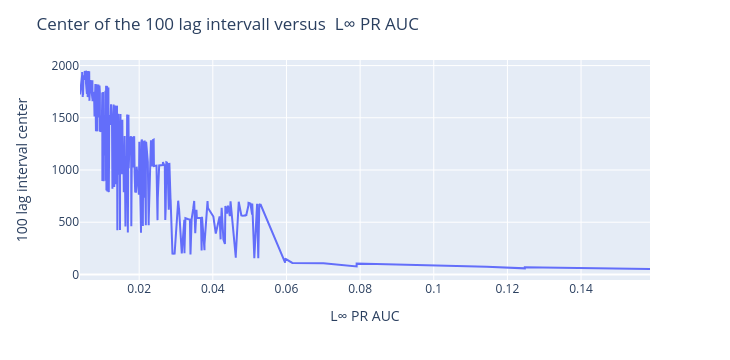

L∞ AUC for 100 lag interval: [(1722, 0.0039330912252075745), (1724, 0.0039330912252075745), (1914, 0.004522821858182202), (1916, 0.004522821858182202), (1918, 0.004522821858182202), (1920, 0.004522821858182202), (1922, 0.004522821858182202), (1924, 0.004522821858182202), (1926, 0.004522821858182202), (1928, 0.004522821858182202), (1930, 0.004522821858182202), (1932, 0.004522821858182202), (1934, 0.004522821858182202), (1936, 0.004522821858182202), (1938, 0.004522821858182202), (1720, 0.004562687039216806), (1908, 0.004652269848079205), (1910, 0.004652269848079205), (1912, 0.004652269848079205), (1700, 0.0046752457000522885)]...
  - optimum lag: 1722
  - optimum PR AUC:  ~=0.79, L∞=0.00
  - selected_lag: 1722 +/- 100 -- optimizing PR AUC with fit time < 60
Information for model with lag: 1722 +/- 100
  - predition time (s):  ~=1.03, L∞=4.29
  - fit time (s):  ~=8.26, L∞=9.92 -- Coefficient [[-0.00227267]] s/lag
  - PR AUC:  ~=0.79, L∞=0.00
  - Mean Square Error :  ~=0.17, L∞=0.00
  - Me

In [12]:
## selecting the most appropriated lag minimizing L∞ over selected_lag +/- delta_lag
## In addition, we want the training model to be lower than 60 seconds.
delta_lag = 100
max_fit_time = 60
selected_lag = forecaster_eval.select_lag_from_forcaster_evaluation( \
    df_auc, delta_lag=delta_lag, max_fit_time=max_fit_time)

In [13]:
## plotting scores of the thresholed forecaster
lag_min = 2
lag_max = 2000
lag_step = 2
df_score, svg = forecaster_eval.plot_thresholded_forecaster_evaluation( lag_min, lag_max, lag_step )
tu.show_svg( svg )

In [14]:
## displaying the scores associated to the selected lag interval
sub_df_score = df_score[ ( df_score[ 'lag' ] >= selected_lag - delta_lag ) & ( df_score['lag'] <= selected_lag + delta_lag ) ]
print( f"Scores for lags: {selected_lag} +/- {delta_lag}\n" )
forecaster_eval.print_mMm_scores( sub_df_score, threshold_var=0.25, score_var=0.25 )


Scores for lags: 1722 +/- 100


Accepted Metrics:
  - f1_binary:[Score:  ~=0.88, L∞=0.00][Threshold:  ~=0.32, L∞=0.13]
  - f1_micro:[Score:  ~=0.78, L∞=0.01][Threshold:  ~=0.32, L∞=0.13]
  - accuracy:[Score:  ~=0.78, L∞=0.01][Threshold:  ~=0.32, L∞=0.13]
  - precision_binary:[Score:  ~=0.97, L∞=0.19][Threshold:  ~=0.98, L∞=0.24]
  - precision_micro:[Score:  ~=0.78, L∞=0.01][Threshold:  ~=0.32, L∞=0.13]
  - average_precision_micro:[Score:  ~=0.80, L∞=0.01][Threshold:  ~=0.73, L∞=0.08]
  - recall_binary:[Score:  ~=0.99, L∞=0.01][Threshold:  ~=0.28, L∞=0.03]
  - recall_micro:[Score:  ~=0.78, L∞=0.01][Threshold:  ~=0.32, L∞=0.13]

Rejected Metrics (Too high variation):



## ForecasterAutoregWithExog / Ridge 

In [15]:
## defining the new forecaster to eval 
forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                          forecaster = 'ForecasterAutoregWithExog')
## plotting AUC, and other performances of the model versus lag
lag_min = 2
lag_max = 2000
lag_step = 2
df_auc, svg = forecaster_eval.plot_lag_forcaster_evaluation( lag_min, lag_max, lag_step )
tu.show_svg( svg )


Storing results in cell_id-0--cat_id-0--pe_id-0


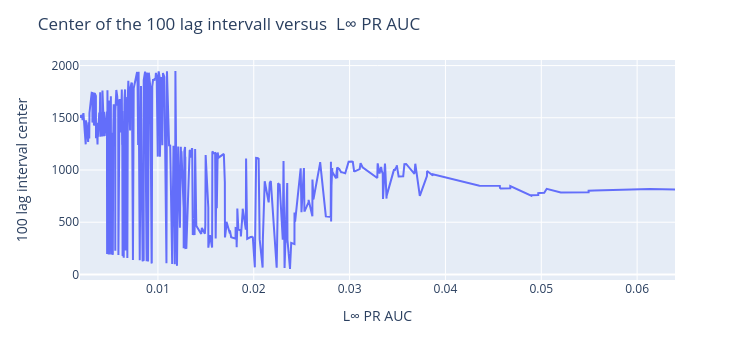

L∞ AUC for 100 lag interval: [(1502, 0.0018713483211346693), (1504, 0.0018713483211346693), (1506, 0.0018713483211346693), (1508, 0.0018713483211346693), (1510, 0.0018713483211346693), (1512, 0.0018713483211346693), (1514, 0.0018713483211346693), (1516, 0.0018713483211346693), (1518, 0.0018713483211346693), (1520, 0.0019636278967860576), (1500, 0.001985028335531158), (1522, 0.0020719451180020165), (1524, 0.0020719451180020165), (1526, 0.0020719451180020165), (1528, 0.0020719451180020165), (1530, 0.0020719451180020165), (1478, 0.002141797668210099), (1480, 0.002141797668210099), (1482, 0.002141797668210099), (1484, 0.002141797668210099)]...
  - optimum lag: 1502
  - optimum PR AUC:  ~=0.81, L∞=0.00
  - selected_lag: 1502 +/- 100 -- optimizing PR AUC with fit time < 60
Information for model with lag: 1502 +/- 100
  - predition time (s):  ~=1.94, L∞=10.71
  - fit time (s):  ~=7.92, L∞=7.79 -- Coefficient [[-0.0018251]] s/lag
  - PR AUC:  ~=0.81, L∞=0.00
  - Mean Square Error :  ~=362.97, 

In [16]:
## selecting the most appropriated lag minimizing L∞ over selected_lag +/- delta_lag
## In addition, we want the training model to be lower than 60 seconds.
delta_lag = 100
max_fit_time = 60
selected_lag = forecaster_eval.select_lag_from_forcaster_evaluation( \
    df_auc, delta_lag=delta_lag, max_fit_time=max_fit_time)

In [17]:
## plotting scores of the thresholed forecaster
lag_min = 2
lag_max = 2000
lag_step = 2
df_score, svg = forecaster_eval.plot_thresholded_forecaster_evaluation( lag_min, lag_max, lag_step )
tu.show_svg( svg )

Since the PR AUC is decreasing, the selected lag value does not seems appropriated, and we force the analysis and performance within an interval of acceptable lag values. In our case, we select that interval to be [0, 250]. 

Selecting according to L∞ on a refined interval [ 0, 250]


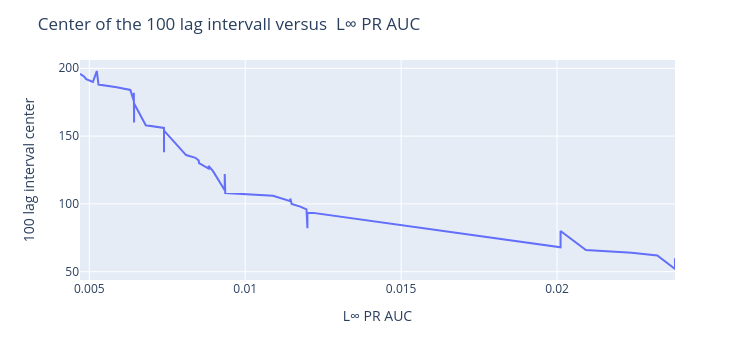

L∞ AUC for 100 lag interval: [(196, 0.004701060878532948), (194, 0.004829251083797281), (192, 0.004899540260009605), (190, 0.0051161521075803185), (198, 0.005239885170289171), (188, 0.0052946262965737345), (186, 0.005879102859371321), (184, 0.006314551055556117), (176, 0.006427314917347493), (178, 0.006427314917347493), (180, 0.006427314917347493), (182, 0.006427314917347493), (160, 0.006435553752758838), (162, 0.006435553752758838), (164, 0.006435553752758838), (166, 0.006435553752758838), (168, 0.006435553752758838), (170, 0.006435553752758838), (172, 0.006435553752758838), (174, 0.006435553752758838)]...
  - optimum lag: 196
  - optimum PR AUC:  ~=0.96, L∞=0.00
  - selected_lag: 196 +/- 100 -- optimizing PR AUC with fit time < 60
Information for model with lag: 196 +/- 100
  - predition time (s):  ~=1.54, L∞=6.01
  - fit time (s):  ~=0.59, L∞=2.47 -- Coefficient [[0.00095131]] s/lag
  - PR AUC:  ~=0.96, L∞=0.00
  - Mean Square Error :  ~=0.13, L∞=0.00
  - Mean Absolute Error :  ~=0.

In [18]:
delta_lag = 100
max_fit_time = 60

print( "Selecting according to L∞ on a refined interval [ 0, 250]" )
df_auc = df_auc[ df_auc[ 'lag' ] <= 250 ]

## selecting the most appropriated lag minimizing L∞ over selected_lag +/- delta_lag
## In addition, we want the training model to be lower than 60 seconds.
selected_lag = forecaster_eval.select_lag_from_forcaster_evaluation( \
    df_auc, delta_lag=delta_lag, max_fit_time=max_fit_time)

## displaying the scores associated to the selected lag interval
sub_df_score = df_score[ ( df_score[ 'lag' ] >= selected_lag - delta_lag ) & ( df_score['lag'] <= selected_lag + delta_lag ) ]
print( f"Scores for lags: {selected_lag} +/- {delta_lag}\n" )
forecaster_eval.print_mMm_scores( sub_df_score, threshold_var=0.25, score_var=0.25 )

# Refining our Single Serie Forecaster/Classifier

To enhance the models, our primary focus was on the number of steps that the forecaster can accurately predict. Additionally, we assessed the stability of the threshold to determine the reliability of our predictions.

In order to assess the predictive capabilities of the model, we utilized the same training set and expanded the number of predictions compared to the true values. We defined the prediction steps as the test_length where the F1 score of the prediction remains above 90%.

It is important to note that this method may introduce bias, as an incorrect initial prediction can significantly impact the overall score. To mitigate this bias, the evaluation of the score should have the ability to skip a few initial values. However, we have not implemented this approach. We have included some partial measurements from the previous section and have refined the number of prediction steps.

| Forcaster / Regressor | Autoreg / RandForest     | A. WithExog / RF | Autoreg / Ridge | A. WithExog / Ridge    |
|-----------------------|--------------------------|------------------|-----------------|------------------------|
| optimum lag           | 1404                     | 94               | 1722            | 196                    |
| optimum PR AUC        | ~=0.87, L∞=0.04          | ~=0.95, L∞=0.02  | ~=0.79, L∞=0.00 | ~=0.96, L∞=0.00        |
| selected_lag          | 412 +/- 100              | 94 +/- 100       | 1722 +/- 100    | 196 +/- 100            |
| model size (KB)       | 2673.87                  | 2338.85          | 105.06          | 62.18                  |
| predition time (s)    | ~=38.95, L∞=31.31        | ~=41.77, L∞=41.16| ~=1.03, L∞=4.29 | ~=1.54, L∞=6.01        |
| fit time (s)          | ~=51.97, L∞=44.48, coef=0.15 s/lag | ~=10.69, L∞=18.50, coef=0.09 s/lag | ~=8.26, L∞=9.92, coef=-0.002 s/lag |  ~=0.59, L∞=2.47, coef=0.00 s/lag |
| PR AUC                | ~=0.87, L∞=0.07          | ~=0.95, L∞=0.02  | ~=0.79, L∞=0.00 |  ~=0.96, L∞=0.00       |
| Mean Square Error     | ~=0.22, L∞=0.08          | ~=0.17, L∞=0.03  | ~=0.17, L∞=0.00 | ~=0.13, L∞=0.00        |
| Mean Absolute Error   | ~=0.28, L∞=0.19          | ~=0.19, L∞=0.03  | ~=0.34, L∞=0.00 | ~=0.31, L∞=0.01        |
| R2 Score              | ~=-0.35, L∞=0.47         | ~=-0.05, L∞=0.18 | ~=-0.04, L∞=0.01| ~=0.18, L∞=0.02        |
| steps Prediction      | 530.00                   | 3455.00 steps    | 3455.00 steps   | 3455.00 steps          |
| **steps Prediction**      | F1 (36,36) / Pr (458,36) | F1 (90,70) Pr (124,70) | F1 (0,0) Pr (22,0)   | F1 (0,0) Pr (2198,0)          |

Based on the findings presented earlier, the Random Forest regressor paired with the ForecasterAutoregWithExog Forecaster is the model that offers reasonable predictions. It can forecast the next 70 seconds with a lag of 94 seconds and detect 'abnormal' traffic within the subsequent 90 seconds.

In terms of the threshold, all combinations exhibit significant stability, possibly due to data saturation.

To summarize, the selected model possesses the following attributes:

| Forcaster / Regressor   |  ForecasterAutoregWithExog / Random Forest |
|-------------------------|--------------------------------------------|
| optimum lag             |  94                                        |
| optimum PR AUC          |  ~=0.95, L∞=0.02                           |
| selected_lag            |  94 +/- 100                                |
| model size (KB)         | 2673.87                                    |
| predition time (s)      |  ~=41.77, L∞=41.16                         |
| fit time (s)            | ~=10.69, L∞=18.50, coef=0.09 s/lag         |
| PR AUC                  |  ~=0.95, L∞=0.02                           |
| Mean Square Error       |  ~=0.17, L∞=0.03                           |
| Mean Absolute Error     |  ~=0.19, L∞=0.03                           |
| R2 Score                |  ~=-0.05, L∞=0.18                          |
| steps Prediction        |  F1 (90,70) Pr (124,70)                    |
| f1_binary               |  ~=0.88, L∞=0.01                           |
| f1_micro                |  ~=0.79, L∞=0.02                           |
| accuracy                |  ~=0.79, L∞=0.02                           |
| precision_binary        |  ~=0.87, L∞=0.21                           |
| precision_micro         |  ~=0.79, L∞=0.02                           |
| average_precision_micro |  ~=0.80, L∞=0.03                           |
| recall_binary           |  ~=1.00, L∞=0.03                           |
| recall_micro            |  ~=0.79, L∞=0.02                           |


Running Hyper parameter tuning returns some optimal parameters max_depoth=10 (default) and n_estimators=102 (default 100).
```
## `Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
##  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
## 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
## 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
## 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94] 
##  Parameters: {'max_depth': 10, 'n_estimators': 102}
##  Backtesting metric: 0.14593510817690716
```
  

In [15]:
## Final forecaster
import os
import time
import skforecast
import time_series_utils as tu


def forecaster_000( data_train ):
  """ returns the final optimum model for 000 """

  lag = 94
  n_estimators=102
  max_depth=10
#  data_id = f"cell_id-{cell_id}--cat_id-{cat_id}--pe_id-{pe_id}"
#  reg_id = f"RandomForestRegressor--n_estimators-{n_estimators}--max_depth-{max_depth}"
#  forecaster_id = f"ForecasterAutoreg--lag-{lag}--{reg_id}"
#  file_name = os.path.join( data_id, '000_optimized_single_serie.pickle' )
#  if os.path.isfile( file_name ):  
#    return skforecast.utils.load_forecaster( file_name, verbose=True )
#    

  regressor = sklearn.ensemble.RandomForestRegressor(\
                  random_state=123,
                  n_estimators=n_estimators,
                  max_depth=max_depth )

  forecaster = skforecast.ForecasterAutoreg.ForecasterAutoreg(
                   regressor = regressor,
                   lags      = lag )
#                   forecaster_id = forecaster_id )
  start = time.time()
  forecaster.fit( y=data_train['y'], exog=data_train['exog_1'] )
  stop = time.time()
  print( f"fit time: {stop - start :.2f}s" )   
#  skforecast.utils.save_forecaster(forecaster, file_name=file_name, verbose=True )
  return forecaster

# formating the dataset
data = tu.NWDAFDataSet ( cell_id=0, cat_id=0, pe_id=0 )
train_len = int( 80 * len( data.df ) / 100 )
data_train, data_test = data.get_train_test( train_len )

forecaster = forecaster_000( data_train )

fit time: 7.84s


/home/mglt/.local/lib/python3.10/site-packages/sklearn/preprocessing/_discretization.py:322: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(


In [20]:
def single_threshold(predictions, data ):
  """ determine the threshold associated to the multi serie prediction 

  The threshold is the one that maximize the average f1 (micro) score over all time series. 
  
  args:
    predictions is a data frame that contains the dates and predictions
    series contains all values and is used to extract the test values 
  """
#  predictions.columns
#  predictions.index

  threshold_min = 0
  threshold_max = 1
  threshold_step = 0.001

  series_dict, exog_dict = get_multi_series_data()
  ## determining the optimum threshold for f1_binary and f1_micro
  threshold_list = np.arange( threshold_min, threshold_max, threshold_step )

  threshold_scores = []
  for threshold in threshold_list:
    y_pred = predictions.between( float( threshold ), float( 1 ), inclusive='right' ).map( {True: 1, False: 0} )
    y_true = data.df.loc[ predictions.index[ 0 ] : predictions.index[ -1 ] ][ 'y' ]
#    print( f"y_true: {y_true}" )  
    threshold_scores.append( sklearn.metrics.f1_score( y_true, y_pred, average='micro' ) )
  optimum_score = max( threshold_scores )
  threshold_candidate = []
  for i, score in enumerate( threshold_scores) :
    if score == optimum_score :
      threshold_candidate.append( i * threshold_step )
  selected_threshold = statistics.median( threshold_candidate )
  print( f"threshold candidates: {threshold_candidate}" )
  print( f"selected threshold : {selected_threshold}" )
  return selected_threshold

## preparing data
data = tu.NWDAFDataSet ( cell_id=0, cat_id=0, pe_id=0 )
train_len = int( 80 * len( data.df ) / 100 )
data_train, data_test = data.get_train_test( train_len )

## training the model
forecaster = forecaster_000( data_train )

## computing threshold
predictions = forecaster.predict( steps=steps, exog=data_test['exog_1'] )
single_thresh = single_threshold(predictions, data )


/home/mglt/.local/lib/python3.10/site-packages/sklearn/preprocessing/_discretization.py:322: UserWarning: Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.
  warnings.warn(


fit time: 24.17s
threshold candidates: [0.353, 0.354, 0.355, 0.356, 0.357, 0.358, 0.359, 0.36, 0.361, 0.362, 0.363, 0.364, 0.365, 0.366, 0.367, 0.368, 0.369, 0.37, 0.371, 0.372, 0.373, 0.374, 0.375, 0.376, 0.377, 0.378, 0.379, 0.38, 0.381, 0.382, 0.383, 0.384, 0.385, 0.386, 0.387, 0.388, 0.389, 0.39, 0.391, 0.392, 0.393, 0.394, 0.395, 0.396, 0.397, 0.398, 0.399, 0.4, 0.401, 0.402, 0.403, 0.404, 0.405, 0.406, 0.40700000000000003, 0.40800000000000003, 0.40900000000000003, 0.41000000000000003, 0.41100000000000003, 0.41200000000000003, 0.41300000000000003, 0.41400000000000003, 0.41500000000000004, 0.41600000000000004, 0.417, 0.418, 0.419, 0.42, 0.421, 0.422, 0.423, 0.424, 0.425, 0.426, 0.427, 0.428, 0.429, 0.43, 0.431, 0.432, 0.433, 0.434, 0.435, 0.436, 0.437, 0.438, 0.439, 0.44, 0.441, 0.442, 0.443, 0.444, 0.445, 0.446, 0.447, 0.448, 0.449, 0.45, 0.451, 0.452, 0.453, 0.454, 0.455, 0.456, 0.457, 0.458, 0.459, 0.46, 0.461, 0.462, 0.463, 0.464, 0.465, 0.466, 0.467, 0.468, 0.46900000000000003

## Steps Prediction

In [92]:
import time_series_utils as tu
import sklearn
from IPython.core.display import SVG


cell_id=0
cat_id=0 
pe_id=0 

# formating the dataset
data = tu.NWDAFDataSet ( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )
train_len = int( 80 * len( data.df ) / 100 )  
test_len = len( data.df ) - train_len

test_steps_max=2200
lag = 1404

regressor = sklearn.ensemble.RandomForestRegressor(\
                  random_state=123,
                  n_estimators=100,
                  max_depth=10 )

forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                          forecaster = 'ForecasterAutoreg')


df, svg_fn = forecaster_eval.plot_forecaster_prediction_steps(lag=lag, test_steps_max=test_steps_max)
tu.show_svg( svg_fn )


Storing results in cell_id-0--cat_id-0--pe_id-0


In [45]:
print( df.columns )
#print( df[ 'score_f1_binary'] )  
#print( df[ 'score_f1_micro'] )  

def get_steps ( score_list, epsilon=0.1 ): 
  for step, score in  enumerate( score_list ):
    if score < 1 - epsilon:
      print( f"First score below {1-epsilon} occurs at step {2 * step} with a score {score}" )
      break  
  if step == len (score_list ) - 1 :      
    print( f"First score below {1-epsilon} occurs at step {2 * step} with a score {score}" )
        
f1_binary_list = df[ 'score_f1_binary'].to_list( )
f1_micro_list =  df[ 'score_f1_micro'].to_list()
precision_binary_list = df[ 'score_precision_binary' ]
precision_micro_list = df[ 'score_precision_micro' ]

get_steps( f1_binary_list )
get_steps( f1_micro_list )
get_steps( precision_binary_list )
get_steps( precision_micro_list )

Index(['pred_time', 'roc_auc', 'pr_auc', 'mean_sqrt', 'mean_abs', 'r2_score',
       'threshold_f1_binary', 'score_f1_binary', 'threshold_f1_micro',
       'score_f1_micro', 'threshold_accuracy', 'score_accuracy',
       'threshold_precision_binary', 'score_precision_binary',
       'threshold_precision_micro', 'score_precision_micro',
       'threshold_average_precision_micro', 'score_average_precision_micro',
       'threshold_recall_binary', 'score_recall_binary',
       'threshold_recall_micro', 'score_recall_micro', 'steps'],
      dtype='object')
First score below 0.9 occurs at step 36 with a score 0.846153846153846
First score below 0.9 occurs at step 36 with a score 0.8947368421052632
First score below 0.9 occurs at step 458 with a score 0.8831168831168831
First score below 0.9 occurs at step 36 with a score 0.8947368421052632


In [46]:

lag = 94

forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                          forecaster = 'ForecasterAutoregWithExog')


df, svg_fn = forecaster_eval.plot_forecaster_prediction_steps(lag=lag, test_steps_max=test_steps_max)
tu.show_svg( svg_fn )

Storing results in cell_id-0--cat_id-0--pe_id-0


In [47]:
f1_binary_list = df[ 'score_f1_binary'].to_list( )
f1_micro_list =  df[ 'score_f1_micro'].to_list()
precision_binary_list = df[ 'score_precision_binary' ]
precision_micro_list = df[ 'score_precision_micro' ]

get_steps( f1_binary_list )
get_steps( f1_micro_list )
get_steps( precision_binary_list )
get_steps( precision_micro_list )

First score below 0.9 occurs at step 90 with a score 0.8941176470588236
First score below 0.9 occurs at step 70 with a score 0.8888888888888888
First score below 0.9 occurs at step 124 with a score 0.8904109589041096
First score below 0.9 occurs at step 70 with a score 0.8888888888888888


In [52]:
regressor = sklearn.linear_model.Ridge(random_state=123)
forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                          forecaster = 'ForecasterAutoreg')

lag = 1722


df, svg_fn = forecaster_eval.plot_forecaster_prediction_steps(lag=lag, test_steps_max=test_steps_max)
tu.show_svg( svg_fn )

Storing results in cell_id-0--cat_id-0--pe_id-0


In [53]:
f1_binary_list = df[ 'score_f1_binary'].to_list( )
f1_micro_list =  df[ 'score_f1_micro'].to_list()
precision_binary_list = df[ 'score_precision_binary' ]
precision_micro_list = df[ 'score_precision_micro' ]

get_steps( f1_binary_list )
get_steps( f1_micro_list )
get_steps( precision_binary_list )
get_steps( precision_micro_list )

First score below 0.9 occurs at step 0 with a score 0.6666666666666666
First score below 0.9 occurs at step 0 with a score 0.5
First score below 0.9 occurs at step 22 with a score 0.6666666666666666
First score below 0.9 occurs at step 0 with a score 0.5


In [58]:
def show_list( the_list, item_nbr=50):
  print( [ f"{i:.3f}" for i in the_list ][ :50 ] )

print( "-- f1_binary_list :" )
show_list( f1_binary_list )
print( "-- f1_micro_list :" )
show_list( f1_micro_list )
print( "-- precision_binary_list" )
show_list( precision_binary_list )
print( "-- precision_micro_list" )
show_list( precision_micro_list )


-- f1_binary_list :
['0.667', '0.667', '0.500', '0.400', '0.333', '0.308', '0.308', '0.308', '0.308', '0.308', '0.308', '0.286', '0.267', '0.267', '0.267', '0.250', '0.250', '0.381', '0.444', '0.485', '0.541', '0.585', '0.596', '0.627', '0.621', '0.645', '0.657', '0.676', '0.693', '0.709', '0.723', '0.736', '0.733', '0.717', '0.702', '0.688', '0.673', '0.660', '0.647', '0.635', '0.623', '0.611', '0.600', '0.589', '0.579', '0.581', '0.595', '0.608', '0.620', '0.632']
-- f1_micro_list :
['0.500', '0.500', '0.333', '0.250', '0.200', '0.250', '0.357', '0.438', '0.500', '0.550', '0.591', '0.583', '0.577', '0.607', '0.633', '0.656', '0.676', '0.639', '0.632', '0.600', '0.595', '0.614', '0.587', '0.604', '0.580', '0.577', '0.574', '0.589', '0.603', '0.617', '0.629', '0.641', '0.636', '0.618', '0.600', '0.583', '0.568', '0.553', '0.538', '0.525', '0.512', '0.512', '0.523', '0.534', '0.544', '0.543', '0.532', '0.521', '0.510', '0.510']
-- precision_binary_list
['1.000', '1.000', '1.000', '1.000

In [59]:

forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                          forecaster = 'ForecasterAutoregWithExog')

lag = 196

df, svg_fn = forecaster_eval.plot_forecaster_prediction_steps(lag=lag, test_steps_max=test_steps_max)
tu.show_svg( svg_fn ) 

Storing results in cell_id-0--cat_id-0--pe_id-0


In [60]:
f1_binary_list = df[ 'score_f1_binary'].to_list( )
f1_micro_list =  df[ 'score_f1_micro'].to_list()
precision_binary_list = df[ 'score_precision_binary' ]
precision_micro_list = df[ 'score_precision_micro' ]

get_steps( f1_binary_list )
get_steps( f1_micro_list )
get_steps( precision_binary_list )
get_steps( precision_micro_list )

First score below 0.9 occurs at step 0 with a score 0.6666666666666666
First score below 0.9 occurs at step 0 with a score 0.5
First score below 0.9 occurs at step 2198 with a score 1.0
First score below 0.9 occurs at step 0 with a score 0.5


In [61]:
print( "-- f1_binary_list :" )
show_list( f1_binary_list )
print( "-- f1_micro_list :" )
show_list( f1_micro_list )
print( "-- precision_binary_list" )
show_list( precision_binary_list )
print( "-- precision_micro_list" )
show_list( precision_micro_list )

-- f1_binary_list :
['0.667', '0.400', '0.500', '0.667', '0.750', '0.778', '0.778', '0.778', '0.778', '0.778', '0.778', '0.778', '0.778', '0.778', '0.778', '0.778', '0.778', '0.700', '0.636', '0.647', '0.684', '0.714', '0.739', '0.760', '0.778', '0.772', '0.746', '0.721', '0.738', '0.754', '0.767', '0.779', '0.769', '0.769', '0.763', '0.744', '0.725', '0.707', '0.703', '0.703', '0.703', '0.703', '0.703', '0.703', '0.703', '0.693', '0.709', '0.723', '0.736', '0.747']
-- f1_micro_list :
['0.500', '0.250', '0.333', '0.500', '0.600', '0.667', '0.714', '0.750', '0.778', '0.800', '0.818', '0.833', '0.846', '0.857', '0.867', '0.875', '0.882', '0.833', '0.789', '0.750', '0.762', '0.773', '0.783', '0.792', '0.800', '0.788', '0.759', '0.732', '0.741', '0.750', '0.742', '0.734', '0.727', '0.735', '0.743', '0.750', '0.743', '0.737', '0.744', '0.750', '0.756', '0.762', '0.767', '0.773', '0.778', '0.772', '0.766', '0.771', '0.776', '0.780']
-- precision_binary_list
['1.000', '1.000', '1.000', '1.000

## Threshold Stability

Storing results in cell_id-0--cat_id-0--pe_id-0
threshold--train_len_13824--forecaster-ForecasterAutoreg--regressor-RandomForestRegressor---steps-None--lag-1404--threshold-0-1-0.001


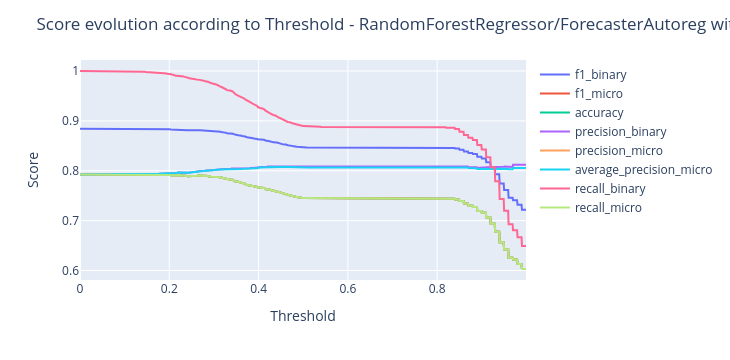

In [38]:
import time_series_utils as tu
import sklearn
from IPython.core.display import SVG

cell_id=0
cat_id=0 
pe_id=0 
    
# formating the dataset
data = tu.NWDAFDataSet ( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )
train_len = int( 80 * len( data.df ) / 100 )   
test_len = len( data.df ) - train_len
    
    
## Random Forest with ForecasterAutoreg
regressor = sklearn.ensemble.RandomForestRegressor(\
                      random_state=123,
                      n_estimators=100,
                      max_depth=10 )
lag = 1404
steps = None
forecaster='ForecasterAutoreg'
forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                              forecaster = forecaster)
df = forecaster_eval.plot_forecaster_score_versus_threshold( lag=lag, steps=steps )


Storing results in cell_id-0--cat_id-0--pe_id-0
threshold--train_len_13824--forecaster-ForecasterAutoregWithExog--regressor-RandomForestRegressor---steps-None--lag-96--threshold-0-1-0.001


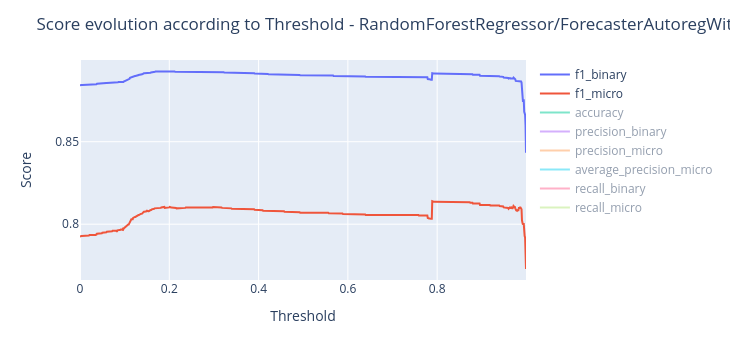

In [2]:
## Random Forest with ForecasterAutoregWithExog
lag = 96
steps = None
forecaster = 'ForecasterAutoregWithExog'
forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                              forecaster = forecaster)
df = forecaster_eval .plot_forecaster_score_versus_threshold( lag=lag, steps=steps )


Storing results in cell_id-0--cat_id-0--pe_id-0
threshold--train_len_13824--forecaster-ForecasterAutoregWithExog--regressor-Ridge---steps-None--lag-1722--threshold-0-1-0.001


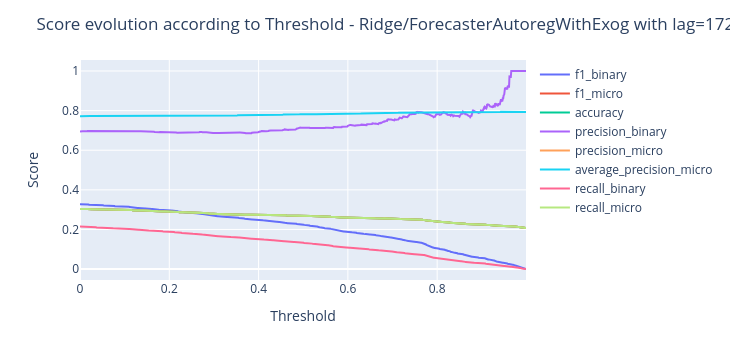

In [3]:
## Ridge with ForecasterAutoreg
lag = 1722
steps = None
regressor = sklearn.linear_model.Ridge(random_state=123)
forcaster='ForecasterAutoreg'
forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                              forecaster = forecaster)
df = forecaster_eval.plot_forecaster_score_versus_threshold( lag=lag, steps=steps )


Storing results in cell_id-0--cat_id-0--pe_id-0
threshold--train_len_13824--forecaster-ForecasterAutoregWithExog--regressor-Ridge---steps-None--lag-196--threshold-0-1-0.001


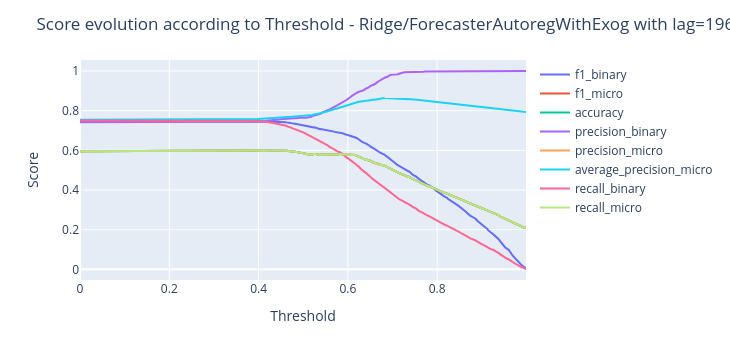

In [4]:
## Ridge with ForecasterAutoreg
lag = 196
steps = steps
forcaster='ForecasterAutoregWithExog'
forecaster_eval = tu.TimeSerieLagAnalysis( data, train_len, regressor,
                                              forecaster = forecaster)
df = forecaster_eval.plot_forecaster_score_versus_threshold( lag=lag, steps=steps )


## Hyperparameter tuning

In [72]:
# Hyperparameter grid search
# ==============================================================================
import skforecast.model_selection
import skforecast.ForecasterAutoreg
import sklearn.ensemble

import time_series_utils as tu

## Selecting aand formating a subset of the data
cell_id = 0
cat_id = 0 
pe_id = 0 

# formating the dataset
data = tu.NWDAFDataSet( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )
train_len = int( 80 * len( data.df ) / 100 )   
data_train, data_test = data.get_train_test( train_len )

data = tu.NWDAFDataSet ( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )

lags = 94
steps = 90

regressor = sklearn.ensemble.RandomForestRegressor(\
                  random_state=123,
                  n_estimators=100,
                  max_depth=10 )

forecaster = skforecast.ForecasterAutoreg.ForecasterAutoreg(
                 regressor = regressor,
                 lags      = lags # This value will be replaced in the grid search
             )

## lag is set to 94 and steps is set to 90
# Candidate values for regressor's hyperparameters
param_grid = {
    'n_estimators': [ 98, 100, 102, 104, 106, 108, 110 ],
    'max_depth': [8, 10, 12 ]
}


results_grid = skforecast.model_selection.grid_search_forecaster(
                   forecaster         = forecaster,
                   y                  = data_train['y'],
                   exog               = data_train['exog_1'], 
                   param_grid         = param_grid,
                   lags_grid          = [ lags ],
                   steps              = steps,
                   refit              = False,
                   metric             = 'mean_squared_error',
                   initial_train_size = int(len(data_train)*0.5),
                   fixed_train_size   = False,
                   return_best        = True,
                   n_jobs             = 'auto',
                   verbose            = False
               )
results_grid

Number of models compared: 21.


lags grid:   0%|          | 0/1 [00:00<?, ?it/s]

params grid:   0%|          | 0/21 [00:00<?, ?it/s]

`Forecaster` refitted using the best-found lags and parameters, and the whole data set: 
  Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94] 
  Parameters: {'max_depth': 10, 'n_estimators': 102}
  Backtesting metric: 0.14593510817690716



/home/mglt/.local/lib/python3.10/site-packages/sklearn/preprocessing/_discretization.py:322: UserWarning:

Bins whose width are too small (i.e., <= 1e-8) in feature 0 are removed. Consider decreasing the number of bins.



,lags,lags_label,params,mean_squared_error,max_depth,n_estimators
9,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 10, 'n_estimators': 102}",0.145935,10,102
10,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 10, 'n_estimators': 104}",0.146066,10,104
13,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 10, 'n_estimators': 110}",0.146419,10,110
11,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 10, 'n_estimators': 106}",0.146436,10,106
5,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 8, 'n_estimators': 108}",0.146789,8,108
18,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 12, 'n_estimators': 106}",0.146944,12,106
2,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 8, 'n_estimators': 102}",0.147007,8,102
6,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 8, 'n_estimators': 110}",0.147062,8,110
17,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 12, 'n_estimators': 104}",0.147081,12,104
3,"[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'max_depth': 8, 'n_estimators': 104}",0.147210,8,104


## Backtesting

In [100]:
import skforecast
import time_series_utils as tu

def backtesting_forecaster( cell_id, cat_id, pe_id):
  ## Selecting aand formating a subset of the data

  # formating the dataset
  data = tu.NWDAFDataSet( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )
#train_len = int( 80 * len( data.df ) / 100 )   
#data_train, data_test = data.get_train_test( train_len )
  lags = 94
  steps = 90
  regressor = sklearn.ensemble.RandomForestRegressor(\
                  random_state=123,
                  n_estimators=102,
                  max_depth=10 )

  forecaster = skforecast.ForecasterAutoreg.ForecasterAutoreg(
                 regressor = regressor,
                 lags      = lags )
   
#  steps = 5 * 90
#  n_backtesting = 90 
#  ## exclude testing on forward, but   
#  ##   
  metric, predictions_backtest = skforecast.model_selection.backtesting_forecaster(
                   forecaster         = forecaster,
                   y                  = data.df['y'],
                   exog               = data.df['exog_1'], 
#                   initial_train_size = len(data.df) - n_backtesting,
                   initial_train_size = lags,
                   fixed_train_size   = False,
                   steps              = steps,
                   metric             = 'mean_squared_error',
                   refit              = True,
                   verbose            = True,
                   show_progress      = True )
  return metric, predictions_backtest, data.id 

cell_id = 0
cat_id = 0 
pe_id = 0 
metric, pred, id = backtesting_forecaster( cell_id, cat_id, pe_id)

print(f"Backtest metric (MSE) {id}: {metric}")

Information of backtesting process
----------------------------------
Number of observations used for initial training: 17190
Number of observations used for backtesting: 90
    Number of folds: 1
    Number of steps per fold: 450
    Number of steps to exclude from the end of each train set before test (gap): 0
    Last fold only includes 90 observations.

Fold: 0
    Training:   2024-01-01 00:00:00 -- 2024-01-01 04:46:29  (n=17190)
    Validation: 2024-01-01 04:46:30 -- 2024-01-01 04:47:59  (n=90)



  0%|          | 0/1 [00:00<?, ?it/s]

Backtest metric (MSE) cell_id-0--cat_id-0--pe_id-0: 0.1372582571754679


## Model Sizes

This section evaluates the size of the selected models.    

In [5]:
import os
import pickle
import time_series_utils as tu
import sklearn
from IPython.core.display import SVG


cell_id=0
cat_id=0 
pe_id=0 

# formating the dataset
data = tu.NWDAFDataSet ( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )
train_len = int( 80 * len( data.df ) / 100 )  
test_len = len( data.df ) - train_len

def get_regressor( regressor_name ):
  """ return the regressor from teh regressor name """  
  if regressor_name == 'RandomForest' :    
    r = sklearn.ensemble.RandomForestRegressor(\
                  random_state=123,
                  n_estimators=100,
                  max_depth=10 )
  elif regressor_name == 'Ridge':
    r = sklearn.linear_model.Ridge(random_state=123)
  else: 
    raise ValueError("Unexpected regressor_name" )
  return r

## selected lag for each forecaster / regressor
lag_dict = { ( 'ForecasterAutoreg', 'RandomForest' ) : 412, 
             ( 'ForecasterAutoregWithExog', 'RandomForest' ) : 94,
             ( 'ForecasterAutoreg', 'Ridge' ) : 1722, 
             ( 'ForecasterAutoregWithExog', 'Ridge' ) : 195 }
            
    
print( "Evaluation of the Model Size" )
for regressor in [ 'RandomForest', 'Ridge' ] :
  for forecaster  in [ 'ForecasterAutoreg', 'ForecasterAutoregWithExog' ]:
    analyzer = tu.TimeSerieLagAnalysis( data, train_len, get_regressor( regressor ), forecaster = forecaster )
    _, _, _, forecaster_model = analyzer.get_prediction( lag_dict[ (forecaster, regressor ) ] )   
    pickle_file = '/tmp/forecaster_model.pickle'
    with open( pickle_file, 'wb') as f:
      pickle.dump( forecaster_model, f, protocol=pickle.HIGHEST_PROTOCOL)
    print( f"{forecaster}/{regressor}: {os.path.getsize( pickle_file ) / 1000 :.2f} Kb" )

Evaluation of the Model Size
Storing results in cell_id-0--cat_id-0--pe_id-0
ForecasterAutoreg/RandomForest: 2673.87 Kb
Storing results in cell_id-0--cat_id-0--pe_id-0
ForecasterAutoregWithExog/RandomForest: 2338.85 Kb
Storing results in cell_id-0--cat_id-0--pe_id-0
ForecasterAutoreg/Ridge: 105.06 Kb
Storing results in cell_id-0--cat_id-0--pe_id-0
ForecasterAutoregWithExog/Ridge: 62.18 Kb


# Forecaster/Classifier based on Independent MultiSeries

Up to this point, we have focused on a single Time Series, but the dataset contains multiple instances of Time Series. Each Time Series comes with its own unique Exogenous data (load), leading us to consider a single model that can handle each series independently: Independent multi-series forecast. This approach is demonstrated in use case 2 of the [Global Forecasting Model](https://cienciadedatos.net/documentos/py44-multi-series-forecasting-skforecast)
.

## Data Formatting for MultiSeries

skforecast allows for the training and testing of a model with multiple Time Series. The interface is quite similar to that used for a single Time Series, with the difference being that when dealing with multiple series, dictionaries of Time Series and Exogenous data are utilized.

This section outlines the process of constructing the training/validation and testing data required by the multi-series forecaster. Once all initial datasets are consolidated into a dictionary, the script provided below demonstrates how to partition the data into distinct subsets. In this instance, the data is split based on specific dates rather than an index. By calculating the date, we can create a training set that represents 70% of the traffic, with the testing data accounting for the final 10% of the traffic. This allocation allows for a 20% portion of the traffic to be used for model validation before testing.

In our particular scenario, we had the option to utilize the validation data in order to determine the threshold associated with our model. Typically, the model generates a probability value ranging from 0 to 1, and based on this probability, we need to classify the traffic as either 'normal' or 'abnormal'. By utilizing a substantial validation data set, we would have been able to perform this classification across the entire data set and over an extended period of time, thereby preventing any artifacts from influencing the threshold.

However, for the sake of simplicity, we did not follow this approach. Instead, we calculated the threshold using the testing set and evaluated the performance of the model on that same testing set. This implies that the threshold is optimized specifically for the testing set. We have observed that the threshold remains relatively stable, so it is reasonable to make such an assumption... although there is a possibility that it may not be entirely accurate.

In [22]:
import pandas as pd
import skforecast
import datetime
import pickle
import os
import time_series_utils as tu
import time 

def get_multi_series_data( ):
  """ build the data set used by a multi serie forecaster """
  multi_series_data_file = 'multi_series_data.pickle'

  if os.path.isfile( multi_series_data_file ) is True:
    with open( multi_series_data_file, 'rb') as f:
      return pickle.load( f )
  else:
    sub_series_list = []
    sub_exog_list = []

    cell_id_list = [0, 1, 2, 3, 4]
    cat_id_list = [0, 1, 2]
    pe_id_list = [0, 1, 2, 3, 4]

    for cell_id in cell_id_list:
      for cat_id in cat_id_list:
        for pe_id in pe_id_list:
          data = tu.NWDAFDataSet ( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )
          sub_series  = data.df[ [ 'y' ] ].reset_index()
          sub_series[ 'series_id' ] = data.id
          sub_series_list.append( sub_series )         
          sub_exog = data.df[ [ 'exog_1' ] ].reset_index()
          sub_exog[ 'series_id' ] = data.id
          sub_exog_list.append( sub_exog )

    series = pd.concat( sub_series_list )
    exog = pd.concat( sub_exog_list )

    series_dict = skforecast.preprocessing.series_long_to_dict(
      data      = series,
      series_id = 'series_id',
      index     = 'date',
      values    = 'y',
      freq      = 'S'
   )

    exog_dict = skforecast.preprocessing.exog_long_to_dict(
      data      = exog,
      series_id = 'series_id',
      index     = 'date',
      freq      = 'S'
   )

    with open( multi_series_data_file, 'wb') as f:
      pickle.dump( ( series_dict, exog_dict ), f, protocol=pickle.HIGHEST_PROTOCOL)
    return series_dict, exog_dict

start = time.time()
series_dict, exog_dict = get_multi_series_data()
stop = time.time()
print( f"Generating Multi Serie Data in {stop - start: .2f}s" )

## start_date = '2024-01-01 00:00:00'
## end_date = '2024-01-01 04:47:58'
## 17280 seconds
## train (70%) , validation ( 20%), test (10% ) 
start_date =  datetime.datetime.fromisoformat('2024-01-01')
end_train = f"{ start_date + datetime.timedelta( seconds=17280 * 70 / 100 )}"
#end_val = f"{ start_date + datetime.timedelta( seconds=17280 * 90 / 100 )}"

series_dict_train = {k: v.loc[: end_train,] for k, v in series_dict.items()}
exog_dict_train   = {k: v.loc[: end_train,] for k, v in exog_dict.items()}
series_dict_test  = {k: v.loc[end_train:,] for k, v in series_dict.items()}
exog_dict_test    = {k: v.loc[end_train:,] for k, v in exog_dict.items()}
test_len = len( series_dict_test[ 'cell_id-0--cat_id-0--pe_id-0' ] )
print( f"test_len: {test_len}" )

Generating Multi Serie Data in  0.10s
test_len: 5184


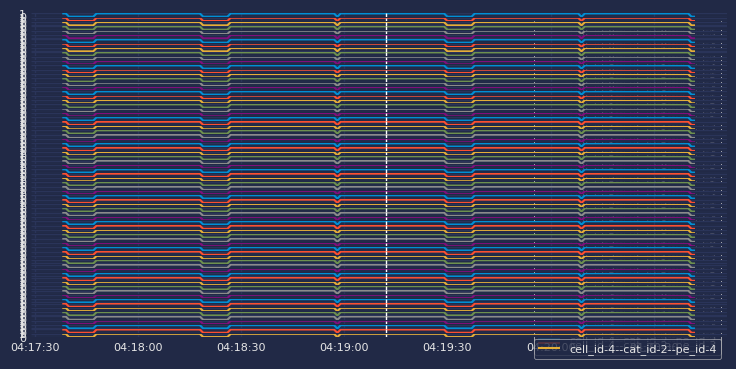

In [23]:
import matplotlib.pyplot as plt
import skforecast.plot

#svg_fn = 'testing_multi_series.svg'
## We plot only the last lags (94) before the testing 
## set and the next steps (90) used for testing 
lag = 94
steps = 90
t_end_val = datetime.datetime.fromisoformat( end_val )
t_start = f"{t_end_val - datetime.timedelta( seconds=lag )}"
t_stop = f"{t_end_val + datetime.timedelta( seconds=steps )}"
skforecast.plot.set_dark_theme()
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']
fig, axs = plt.subplots( len( series_dict ), 1, figsize=(8, 4), sharex=True)
for i, s in enumerate(series_dict.values()):
    s = s.loc[t_start : t_stop ] 
    axs[i].plot(s, label=s.name, color=colors[i%len(colors)])
    axs[i].legend(loc='upper right', fontsize=8)
    axs[i].tick_params(axis='both', labelsize=8)
    axs[i].axvline(pd.to_datetime(end_val) , color='white', linestyle='--', linewidth=1) # End validaton
#fig.savefig( svg_fn )

In [24]:
# Description of each series
# ==============================================================================
for k in list(series_dict.keys())[:5]:
  print(f"{k}:")
  try:
    print( f"\tTrain: len={len(series_dict_train[k])}, {series_dict_train[k].index[0]}"
           f" --- {series_dict_train[k].index[-1]}" )
  except:
    print(f"\tTrain: len=0")
  try:
    print( f"\tTest : len={len(series_dict_test[k])}, {series_dict_test[k].index[0]}"
           f" --- {series_dict_test[k].index[-1]}" )
  except:
    print(f"\tTest : len=0")
# Exogenous variables for each series
# ==============================================================================
for k in list(series_dict.keys())[:5]:
  print(f"{k}:")
  try:
    print(f"\t{exog_dict[k].columns.to_list()}")
  except:
    print(f"\tNo exogenous variables")        

cell_id-0--cat_id-0--pe_id-0:
	Train: len=12097, 2024-01-01 00:00:00 --- 2024-01-01 03:21:36
	Test : len=5184, 2024-01-01 03:21:36 --- 2024-01-01 04:47:59
cell_id-0--cat_id-0--pe_id-1:
	Train: len=12097, 2024-01-01 00:00:00 --- 2024-01-01 03:21:36
	Test : len=5184, 2024-01-01 03:21:36 --- 2024-01-01 04:47:59
cell_id-0--cat_id-0--pe_id-2:
	Train: len=12097, 2024-01-01 00:00:00 --- 2024-01-01 03:21:36
	Test : len=5184, 2024-01-01 03:21:36 --- 2024-01-01 04:47:59
cell_id-0--cat_id-0--pe_id-3:
	Train: len=12097, 2024-01-01 00:00:00 --- 2024-01-01 03:21:36
	Test : len=5184, 2024-01-01 03:21:36 --- 2024-01-01 04:47:59
cell_id-0--cat_id-0--pe_id-4:
	Train: len=12097, 2024-01-01 00:00:00 --- 2024-01-01 03:21:36
	Test : len=5184, 2024-01-01 03:21:36 --- 2024-01-01 04:47:59
cell_id-0--cat_id-0--pe_id-0:
	['exog_1']
cell_id-0--cat_id-0--pe_id-1:
	['exog_1']
cell_id-0--cat_id-0--pe_id-2:
	['exog_1']
cell_id-0--cat_id-0--pe_id-3:
	['exog_1']
cell_id-0--cat_id-0--pe_id-4:
	['exog_1']


## Training MultiSerie versus Single Serie Forecaster/Classifier

This segment involves training a model using all time series. The regressor and forecaster have been selected based on the analysis of the series (0,0,0). It is assumed that the regressor and forecaster (along with associated parameters like lag and other hyperparameters) that performed well for the (0,0,0) Time Series are also optimal for all Time Series. Additional testing may be necessary to confirm its validity.

The training duration for a multi-series is 1269 seconds, approximately 21 minutes, compared to 10.7 seconds for a single model. With 75 Time Series, the average training time per series is 16.92 seconds. This is expected, as training across multiple Time Series involves considering cross-correlation between each individual Time Series.

Conversely, the prediction time for a multi-series is 65 seconds (for all series) compared to 41 seconds for a single series. Essentially, prediction for a single series is much quicker - roughly 0.8 seconds per series.

Regularly training our model to capture the latest trends could be beneficial. The primary challenge lies in obtaining predictions promptly and incorporating the most recent measurements. If we can generate a model within 1 second, we can predict for each new set of data almost instantaneously. However, if prediction takes 10 seconds, early predictions become unattainable. Particularly, by the time predictions are made, the first 11 steps have already passed. In our scenario, for a single Time Series, we found that the model can predict 90 steps with reasonable accuracy. If training takes 11 seconds, training at every step 79 can be considered.

Based on the 'lag' of 94 seconds, 'steps' of 90 seconds, and a prediction time (tp) of 42 seconds, the model is suitable for deployment since the training time is within the prediction time limit - usually 'steps' > 2 * tp as shown in the figure below. The Multi Serie Model doe snot match that condition ;-).

<figure>
  <img src="./time_line.svg" width="60%" />
  <figcaption>Time Line Deployment </figcaption>
</figure>


After training the model, a threshold is established to differentiate between 'normal' and 'abnormal'. This threshold is calculated across all Time Series, rather than individually for each Time Series. The determination of the threshold is straightforward, without any sophisticated methods. Each potential threshold is evaluated based on the mean f1 score across all series. The thresholds that maximize the f1 score are retained, and the median threshold from this list is selected as the multi-series threshold. The resulting threshold is 0.037.

The table below recap some characteristics of the two models:

Both use ForecasterAutoregWithExog with a Random Forest regressor and a selected lag of 94

| Forcaster / Classifier  |   Single Serie  | MultiSerie               |
|-------------------------|-----------------|--------------------------|
| model size (MB)         | 2.67            |  5.23                    |
| predition time (s)      | 41.77           |  65                      |
| fit time (s)            | 10.69           |  1269 # 21 minutes       |

In [25]:
## fit time takes 1269.61s
import sklearn
import skforecast.ForecasterAutoregMultiSeries

def multi_forcaster( series_dict_train,  exog_dict_train ):
  file_name = '000_multi_serie_forecaster.pickle'
  if os.path.isfile( file_name ):  
    return skforecast.utils.load_forecaster( file_name, verbose=True )
     

  ## regressor is set with the optimized parameters
  n_estimators = 102
  max_depth = 10
  multi_regressor = sklearn.ensemble.RandomForestRegressor(\
                      random_state=123,
                      n_estimators=n_estimators,
                      max_depth=max_depth )

  ## we set lag with the value we found
  lags = 94
  multi_forecaster = skforecast.ForecasterAutoregMultiSeries.ForecasterAutoregMultiSeries(
                regressor          = multi_regressor,
                lags               = lags,
                encoding           = "ordinal",
                dropna_from_series = False
            )
  start = time.time()
  multi_forecaster.fit(series=series_dict_train, exog=exog_dict_train, suppress_warnings=True)
  stop = time.time()
  print( f"fit time: {stop - start :.2f}s" )
  skforecast.utils.save_forecaster(multi_forecaster, file_name=file_name, verbose=True )
  return multi_forecaster
    
series_dict, exog_dict = get_multi_series_data()
start_date =  datetime.datetime.fromisoformat('2024-01-01')
end_train = f"{ start_date + datetime.timedelta( seconds=17280 * 70 / 100 )}"
#end_val = f"{ start_date + datetime.timedelta( seconds=17280 * 90 / 100 )}"

series_dict_train = {k: v.loc[: end_train,] for k, v in series_dict.items()}
exog_dict_train   = {k: v.loc[: end_train,] for k, v in exog_dict.items()}

multi_forecaster = multi_forcaster( series_dict_train,  exog_dict_train ) 

ForecasterAutoregMultiSeries 
Regressor: RandomForestRegressor(max_depth=10, n_estimators=102, random_state=123) 
Lags: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94] 
Transformer for series: StandardScaler() 
Transformer for exog: None 
Series encoding: ordinal 
Window size: 94 
Series levels (names): cell_id-0--cat_id-0--pe_id-0, cell_id-0--cat_id-0--pe_id-1, cell_id-0--cat_id-0--pe_id-2, cell_id-0--cat_id-0--pe_id-3, cell_id-0--cat_id-0--pe_id-4, ... 
Series weights: None 
Weight function included: False 
Differentiation order: None 
Exogenous included: True 
Type of exogenous variable: <class 'dict'> 
Exogenous variables names: ['exog_1'] 
Training range: 'cell_id-0--cat_id-0--pe_id-0': ['2024-01-01 00:00:00', '2024-01-01 03:21:36'], 'cell_id-0--

In [26]:
# Predict
## predictions takes 65 seconds
# ==============================================================================
steps = 90
start = time.time()
predictions = multi_forecaster.predict(steps=steps, exog=exog_dict_test, suppress_warnings=True)
stop = time.time()
print( f"prediction time: {stop-start:0.2}s" )
predictions

prediction time: 6.8e+01s


,cell_id-0--cat_id-0--pe_id-0,cell_id-0--cat_id-0--pe_id-1,cell_id-0--cat_id-0--pe_id-2,cell_id-0--cat_id-0--pe_id-3,cell_id-0--cat_id-0--pe_id-4,cell_id-0--cat_id-1--pe_id-0,cell_id-0--cat_id-1--pe_id-1,cell_id-0--cat_id-1--pe_id-2,cell_id-0--cat_id-1--pe_id-3,cell_id-0--cat_id-1--pe_id-4,...,cell_id-4--cat_id-1--pe_id-0,cell_id-4--cat_id-1--pe_id-1,cell_id-4--cat_id-1--pe_id-2,cell_id-4--cat_id-1--pe_id-3,cell_id-4--cat_id-1--pe_id-4,cell_id-4--cat_id-2--pe_id-0,cell_id-4--cat_id-2--pe_id-1,cell_id-4--cat_id-2--pe_id-2,cell_id-4--cat_id-2--pe_id-3,cell_id-4--cat_id-2--pe_id-4
2024-01-01 03:21:37,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2024-01-01 03:21:38,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2024-01-01 03:21:39,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2024-01-01 03:21:40,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2024-01-01 03:21:41,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-01 03:23:02,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,...,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729,0.035729
2024-01-01 03:23:03,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,...,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316,0.032316
2024-01-01 03:23:04,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,...,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052,0.952052
2024-01-01 03:23:05,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [27]:
import numpy as np
import statistics



def multi_threshold(predictions, series_dict ):
  """ determine the threshold associated to the multi serie prediction 

  The threshold is the one that maximize the average f1 (micro) score over all time series. 
  
  args:
    predictions is a data frame that contains the dates and predictions
    series contains all values and is used to extract the test values 
  """
#  predictions.columns
#  predictions.index

  threshold_min = 0
  threshold_max = 1
  threshold_step = 0.001

  series_dict, exog_dict = get_multi_series_data()
  ## determining the optimum threshold for f1_binary and f1_micro
  threshold_list = np.arange( threshold_min, threshold_max, threshold_step )

  threshold_scores = []
  for threshold in threshold_list:
    score_list = []
    ## compute the mean score across all series  
    for serie_name in predictions.columns :  
      y_pred = predictions[ serie_name ].between( float( threshold ), float( 1 ), inclusive='right' ).map( {True: 1, False: 0} )
      y_true = series_dict[ serie_name ].loc[ predictions.index[ 0 ] : predictions.index[ -1 ] ] 
      # y_true = series_dict[ 'cell_id-0--cat_id-0--pe_id-0' ].loc[ predictions.index[ 0 ] : predictions.index[ -1 ] ] 
      score_list.append( sklearn.metrics.f1_score( y_true, y_pred, average='micro' ) )
    threshold_scores.append( statistics.mean( score_list ) )
#  print( f"threshold_scores : {threshold_scores}")
  optimum_score = max( threshold_scores )
  threshold_candidate = []
  for i, score in enumerate( threshold_scores) :
    if score == optimum_score :
      threshold_candidate.append( i * threshold_step )
  selected_threshold = statistics.median( threshold_candidate )
  print( f"threshold candidates: {threshold_candidate}" )
  print( f"selected threshold : {selected_threshold}" )
  return selected_threshold

series_dict, exog_dict = get_multi_series_data()

selected_threshold = multi_threshold( predictions, series_dict )     

threshold candidates: [0.0, 0.001, 0.002, 0.003, 0.004, 0.005, 0.006, 0.036000000000000004, 0.037, 0.038, 0.039, 0.04, 0.041, 0.042, 0.043000000000000003, 0.044, 0.045]
selected threshold : 0.037


## Performance MultiSeries versus Single Serie Forecaster/Classifier



In this section, we analyze the performance of the multi-series model in comparison to the single-series model. It is important to note that the creation of these two models is not done independently, and certain assumptions are made during this process. 


**The Single Time Serie Forecaster/Classifier**
 
Initially, the forecaster is constructed using a single Time Series (0,0,0), which is then trained on 80% of the data related to this Time Series (see 'forcaster000'). The study has identified the forecaster type ('ForecasterAutoregWithExog') and the regressor type ('RandomForestRegressor') with optimal parameters for both the regressor and the forecaster, specifically the 'lag' and 'step' parameters. 

Following the training of the model, the next 'step' predicted values are treated as probabilities by a classifier to determine whether the predicted value is 'normal' or 'abnormal'. This is achieved by predicting values on the test data and comparing them with the actual values to determine a threshold value. This threshold value is set to maximize the f1 score of the forecaster. 

The Single Forecaster/Classifier consists of a forecaster (model) and a classifier (threshold). One potential concern is that the test data has been used for both optimizing the classifier and evaluating the forecaster/classifier. 

This Forecaste/Classifier can only be used to predict the (0,0,0) Time Serie. As a result, the comparison of the performances between the Single Time Serie and the MultiSerie can only be base don scores established with the (0, 0, 0) Time Serie.  

By curiosity, the 0,0,0 Forecaster/Classifier has been applied to ALL Time Series. Applying the model trained for the (0, 0, 0) Time Serie to the other Time Series implicitly imply we assume that these Time Series will exhibit similar behavior to the (0,0,0) Time Series.


**The Multi Time Series Forecaster/Classifier**

The multi-series forecaster utilizes the outcomes of the Single Time Series Forecaster by incorporating the type of forecaster ('ForecasterAutoregWithExog'), the type of regressor ('RandomForestRegressor'), and the optimal parameters for both the regressor and the forecaster, specifically the 'lag' and 'step' parameters. The forecaster model undergoes its own training process. Predictions are generated from this model, and a threshold is determined for this classifier. The threshold is calculated to enhance the f1 score across the next 'step' predicted values. In this scenario, the MultiSeries Classifier is fine-tuned for the upcoming 'step' predictions, resulting in an average value across the various Time Series.

To assess the MultiSeries Classifier, the 'step' events following the training set is predicted for ALL Time Series. The errors and scores associated with these predictions are computed, and the mean values across all time series are considered as the global error/score of the classifier across all Time Series.

It is important to note that in both instances, the training set constitutes 80% of the data length, and the test set immediately follows the training set. If predictions are not made right after the training set, the lag windows must be specified with the appropriate inputs for the model. For the multi-forecaster, the predictions would be provided as follows:  

```
multi_window    = pd.DataFrame( {k: v[ test_index - lag : test_index ] for k, v in series_dict.items()} 
multi_pred = multi_forecaster.predict( steps=steps, 
                                      exog=exog_dict_test,
                                      last_window=multi_window,
                                      suppress_warnings=True )
```
for the forcaster prediction would be provided as follows:

```
data_test = data.df[ test_index : ]
window = data.df[ test_index - lag : test_index ][ 'y']
exog = data.df[  test_index : test_index + steps ][ 'exog_1' ]
single_forcaster = forecaster_000( cell_id=0, cat_id=0, pe_id=0 )  
single_pred = single_forecaster.predict( steps=steps, 
                                         last_window=window,
                                         exog=exog )

```
We tested the (0, 0, 0) Time Serie and compared the F1 score that we obtained using the SingleSerie and the MultiSerie models. The outcome are summurized  in the table below:


| Forcaster / Classifier  |   Single Serie  | MultiSerie                      |
|-------------------------|-----------------|---------------------------------|
| model size (MB)         | 2.67            |  5.23                           |
| predition time (s)      | 41.77           |  65                             |
| fit time (s)            | 10.69           |  1269 # 21 minutes              |
| f1 (binary)             | 0.6             |  0.61   ($\delta_r = + 0.8$ % ) |
| f1 (micro)              | 0.49            |  0.5    ($\delta_r = + 2.22$ % )|

In that specific case, the MultiSerie performs slightly better than the SingleSerie. With a relative improvement between 0.8 and 2.22 %. 

In [23]:
import os
import statistics
import pandas as pd
import numpy as np
from IPython.display import HTML


metric_list = [ 'mse', 'mae', 'f1_binary', 'f1_micro' ]
metrics = { 'data_id' : [] }
for m in metric_list:
  metrics[ f'{m}_single' ] = []
  metrics[ f'{m}_multi' ] = [] 


results_file_name = 'results_multi_single000.pickle' 

if os.path.isfile( results_file_name ) is True:
  results = pd.read_pickle( results_file_name )
else:
    
  ### Initializing models and getting threshold

  ## A) multi series
    ## preparing training data   
  series_dict, exog_dict = get_multi_series_data() 
  start_date =  datetime.datetime.fromisoformat('2024-01-01')
  end_train = f"{ start_date + datetime.timedelta( seconds=17280 * 80 / 100 )}"
  series_dict_train = {k: v.loc[: end_train,] for k, v in series_dict.items()}
  exog_dict_train   = {k: v.loc[: end_train,] for k, v in exog_dict.items()}
    ## training the model  
  multi_forecaster = multi_forcaster( series_dict_train,  exog_dict_train ) 
    ## predicting 'steps' right after the training                                     
  multi_pred = multi_forecaster.predict( steps=steps, 
                                      exog=exog_dict_test,
                                      suppress_warnings=True )
  multi_thresh = multi_threshold( predictions, series_dict ) 
    
  ## B) single serie 000  
    ## preparing data
  data = tu.NWDAFDataSet ( cell_id=0, cat_id=0, pe_id=0 )
  train_len = int( 80 * len( data.df ) / 100 )
  data_train, data_test = data.get_train_test( train_len )
    ## training the model
  single_forecaster = forecaster_000( data_train )
    ## computing threshold
  predictions = single_forecaster.predict( steps=steps, exog=data_test['exog_1'] )
  single_thresh = single_threshold(predictions, data )
      
  cell_id_list = [0, 1, 2, 3, 4]
  cat_id_list = [0, 1, 2]
  pe_id_list = [0, 1, 2, 3, 4]
          
  for cell_id in cell_id_list:
    for cat_id in cat_id_list:
      for pe_id in pe_id_list:  
        data = tu.NWDAFDataSet( cell_id=cell_id, cat_id=cat_id, pe_id=pe_id )
        train_len = int( 80 * len( data.df ) / 100 )
        data_train, data_test = data.get_train_test( train_len )
        single_forecaster = forecaster_000( data_train )
        single_pred = single_forecaster.predict( steps=steps, exog=data_test['exog_1'] )
          
        metrics[ 'data_id' ].append( data.id )
        metrics[ 'mse_multi' ].append( sklearn.metrics.mean_squared_error( y_true, multi_pred[ data.id ] ) )
        metrics[ 'mse_single' ].append( sklearn.metrics.mean_squared_error( y_true, single_pred ) )
        metrics[ 'mae_multi' ].append( sklearn.metrics.mean_absolute_error( y_true, multi_pred[ data.id ] ) )
        metrics[ 'mae_single' ].append( sklearn.metrics.mean_absolute_error( y_true, single_pred ) )

        thresh_single_pred = single_pred.between( float( single_thresh ), float( 1 ), inclusive='right' ).map( {True: 1, False: 0} )
        thresh_multi_pred =   multi_pred[ data.id ].between( float( multi_thresh ), float( 1 ), inclusive='right' ).map( {True: 1, False: 0} )
        
        metrics[ 'f1_binary_single' ].append( sklearn.metrics.f1_score( y_true, thresh_single_pred, average='binary', pos_label=1) )
        metrics[ 'f1_binary_multi' ].append( sklearn.metrics.f1_score( y_true, thresh_multi_pred, average='binary', pos_label=1) )  
        metrics[ 'f1_micro_single' ].append( sklearn.metrics.f1_score( y_true, thresh_single_pred, average='micro' ) )
        metrics[ 'f1_micro_multi' ].append( sklearn.metrics.f1_score( y_true, thresh_multi_pred, average='micro' ) )        

  results = pd.DataFrame( metrics )
  results = results.set_index( 'data_id' ) 
  results.to_pickle( results_file_name )

def print_all( results ):
  """prints nicely all the results fields """  
  for m in metric_list:
    results[f'{m}_delta_(%)'] = 100 * results.eval(f'({m}_multi - {m}_single) / {m}_multi')
  results = results.round(2)
#  html = results.style.bar(subset=[f'{m}_delta_(%)' for m in metric_list ], align='mid', color=['#d65f5f', '#5fba7d']).to_html( )  
  return results.style.bar(subset=[f'{m}_delta_(%)' for m in metric_list ], align='mid', color=['#d65f5f', '#5fba7d']).to_html( )  

def print_necessary( results ):
  """ prints nicely only the necessary results """    
  ## only keeping the row cell_id-0--cat_id-0--pe_id-0
  results = results[ : 1]   
  ## removing errors from results
  results = results.drop( columns=[ 'mse_single', 'mae_single', 'mae_multi', 'mse_multi' ] )
  ## removing error from metric_list
  metric_list = [ 'f1_binary', 'f1_micro']
  for m in metric_list:
    results[f'{m}_delta_(%)'] = 100 * results.eval(f'({m}_multi - {m}_single) / {m}_multi')
  results = results.round(2)
#  html = results.style.bar(subset=[f'{m}_delta_(%)' for m in metric_list ], align='mid', color=['#d65f5f', '#5fba7d']).to_html( )  
  return results.style.bar(subset=[f'{m}_delta_(%)' for m in metric_list ], align='mid', color=['#d65f5f', '#5fba7d']).to_html( )  
                
    

display(HTML(print_necessary( results )))

,f1_binary_single,f1_binary_multi,f1_micro_single,f1_micro_multi,f1_binary_delta_(%),f1_micro_delta_(%)
data_id,,,,,,
cell_id-0--cat_id-0--pe_id-0,0.600000,0.610000,0.490000,0.500000,0.860000,2.220000


In [24]:
## displaying the full result table. 
## We just let it as a curiosity since it uses the (0,0,0) Single 
## Serie model for different Series.  
display(HTML(print_all( results )))

,mse_single,mse_multi,mae_single,mae_multi,f1_binary_single,f1_binary_multi,f1_micro_single,f1_micro_multi,mse_delta_(%),mae_delta_(%),f1_binary_delta_(%),f1_micro_delta_(%)
data_id,,,,,,,,,,,,
cell_id-0--cat_id-0--pe_id-0,0.400000,0.400000,0.480000,0.450000,0.600000,0.610000,0.490000,0.500000,-0.720000,-6.560000,0.860000,2.220000
cell_id-0--cat_id-0--pe_id-1,0.180000,0.400000,0.180000,0.450000,0.900000,0.610000,0.820000,0.500000,55.420000,60.220000,-48.260000,-64.440000
cell_id-0--cat_id-0--pe_id-2,0.180000,0.400000,0.180000,0.450000,0.900000,0.610000,0.820000,0.500000,55.420000,60.220000,-48.260000,-64.440000
cell_id-0--cat_id-0--pe_id-3,0.530000,0.400000,0.640000,0.450000,0.240000,0.610000,0.280000,0.500000,-31.830000,-42.890000,61.340000,44.440000
cell_id-0--cat_id-0--pe_id-4,0.320000,0.400000,0.370000,0.450000,0.730000,0.610000,0.580000,0.500000,19.750000,16.940000,-20.320000,-15.560000
cell_id-0--cat_id-1--pe_id-0,0.530000,0.400000,0.640000,0.450000,0.240000,0.610000,0.280000,0.500000,-31.830000,-42.890000,61.340000,44.440000
cell_id-0--cat_id-1--pe_id-1,0.180000,0.400000,0.180000,0.450000,0.900000,0.610000,0.820000,0.500000,55.420000,60.220000,-48.260000,-64.440000
cell_id-0--cat_id-1--pe_id-2,0.180000,0.400000,0.180000,0.450000,0.900000,0.610000,0.820000,0.500000,55.420000,60.220000,-48.260000,-64.440000
cell_id-0--cat_id-1--pe_id-3,0.530000,0.400000,0.640000,0.450000,0.240000,0.610000,0.280000,0.500000,-31.830000,-42.890000,61.340000,44.440000


In [34]:
print( "Average of the relative improvement of the multiforcaster over the 000 forcaster" )
for m in metric_list:
  print( f"  - {m}:  {results[f'{m}_delta_(%)'].mean():.2f}%" )


Average of the relative improvement of the multiforcaster over the 000 forcaster
  - mse:  15.25%
  - mae:  13.78%
  - f1_binary:  -3.37%
  - f1_micro:  -16.33%


## backtesting

In [101]:
import skforecast.ForecasterAutoregMultiSeries
import skforecast.model_selection_multiseries

#print( series_dict_train )
lags = 94
steps = 5 * 90
# Backtesting
# ==============================================================================
forecaster = skforecast.ForecasterAutoregMultiSeries.ForecasterAutoregMultiSeries(
                 regressor          = regressor, 
                 lags               = lags, 
                 encoding           = "ordinal", 
                 dropna_from_series = False
             )
### same model
metrics_levels, backtest_predictions = skforecast.model_selection_multiseries.backtesting_forecaster_multiseries(
    forecaster            = forecaster,
    series                = series_dict,
    exog                  = exog_dict,
    steps                 = steps,
    metric                = "mean_absolute_error",
    initial_train_size    = len(series_dict_train[ 'cell_id-0--cat_id-0--pe_id-0' ]),
    fixed_train_size      = True,
    gap                   = 0,
    allow_incomplete_fold = True,
    refit                 = False,
    n_jobs                ="auto",
    verbose               = True,
    show_progress         = True,
    suppress_warnings     = True
)

#display(metrics_levels)
#print("")
#display(backtest_predictions)

Information of backtesting process
----------------------------------
Number of observations used for initial training: 12097
Number of observations used for backtesting: 5183
    Number of folds: 12
    Number of steps per fold: 450
    Number of steps to exclude from the end of each train set before test (gap): 0
    Last fold only includes 233 observations.

Fold: 0
    Training:   2024-01-01 00:00:00 -- 2024-01-01 03:21:36  (n=12097)
    Validation: 2024-01-01 03:21:37 -- 2024-01-01 03:29:06  (n=450)
Fold: 1
    Training:   2024-01-01 00:00:00 -- 2024-01-01 03:21:36  (n=12097)
    Validation: 2024-01-01 03:29:07 -- 2024-01-01 03:36:36  (n=450)
Fold: 2
    Training:   2024-01-01 00:00:00 -- 2024-01-01 03:21:36  (n=12097)
    Validation: 2024-01-01 03:36:37 -- 2024-01-01 03:44:06  (n=450)
Fold: 3
    Training:   2024-01-01 00:00:00 -- 2024-01-01 03:21:36  (n=12097)
    Validation: 2024-01-01 03:44:07 -- 2024-01-01 03:51:36  (n=450)
Fold: 4
    Training:   2024-01-01 00:00:00 -- 2024-

  0%|          | 0/12 [00:00<?, ?it/s]